In [91]:
%load_ext autoreload
%autoreload 2
# Import Python standard library and IPython packages we need.
import os
import subprocess
import sys
import csv
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd 
import seaborn as sns
from collections import defaultdict

# Ask GRASS GIS where its Python packages are.
gisbase = subprocess.check_output(["grass", "--config", "path"], text=True).strip()
os.environ["GISBASE"] = gisbase
sys.path.append(os.path.join(gisbase, "etc", "python"))

# Import the GRASS GIS packages we need.
import grass.script as gs
import grass.jupyter as gj

# Helper function saved in rapid_dem.py
%autoreload 2
import rapid_dem as rd

# Start GRASS Session
## Set your grass data location
gj.init("../../../grassdata", "nc_spm_08_grass7", "rapid-dem")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# View NED 1/9 sec (3m) DEM data from USGS

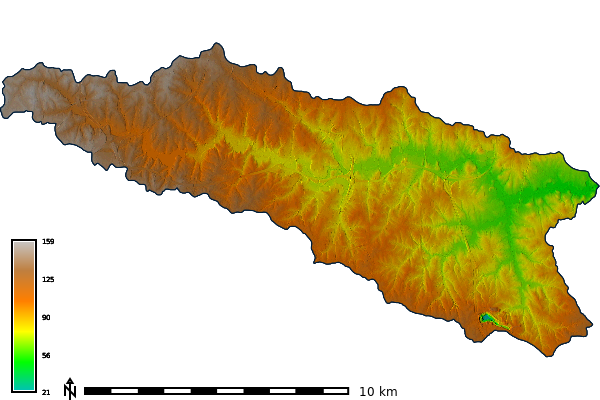

In [92]:
gs.parse_command("g.region", raster="ned_19sec", res=3, flags="p")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)
ned_19sec_map = gj.GrassRenderer(filename="output/ned_19sec_shaded_relief.png")
ned_19sec_map.d_rast(map="ned_19sec_shaded_relief")
ned_19sec_map.d_vect(map="walnut_creek", fill_color="none")
ned_19sec_map.d_legend(raster="ned_19sec", at=(2,40,2,6))
ned_19sec_map.d_barscale(at=(10,6,10,10), units="kilometers", flags="n")
ned_19sec_map.show()

# Import UAS Data

## Site 1 - Nov 23, 2021

### Import 15cm Data

In [ ]:
rd.import_uas_data(
    dtm_input="data/site_1/odm_dem/dtm.tif",
    dtm_output="site_1_dtm_15cm",
    dsm_input="data/site_1/odm_dem/dsm.tif",
    dsm_output="site_1_dsm_15cm",
    ortho_input="data/site_1/odm_orthophoto/odm_orthophoto.tif",
    ortho_output="site_1_ortho_15cm",
    ortho_composite="site_1_ortho_composite_15cm",
    laz_input="data/site_1/odm_georeferenced_model.laz", 
    laz_output="cary_town_blvd_flight_1_odm_pc",
    laz_dsm="cary_town_blvd_flight_1_pc_dsm_05m",
    res=0.15,
    memory=5000, 
    nprocs=12,
    overwrite=True
)

### Resample Data to 3m

In [96]:
rd.resample_uas_data(
    dtm="site_1_dtm_15cm", 
    dtm_output="site_1_dtm_3m_hd", 
    dsm="site_1_dsm_15cm",
    dsm_output="site_1_dsm_3m_hd", 
    ortho="site_1_ortho_composite_15cm", 
    ortho_output="site_1_ortho_composite_3m_hd", 
    red="site_1_ortho_15cm.3",
    red_output="site_1_ortho_3m_hd.r",
    green="site_1_ortho_15cm.2",
    green_output="site_1_ortho_3m_hd.g",
    blue="site_1_ortho_15cm.1",
    blue_output="site_1_ortho_3m_hd.b",
    nir="site_1_ortho_15cm.4",
    nir_output="site_1_ortho_3m_hd.n",
    res=3, overwrite=True)

('site_1_dtm_3m_hd',
 'site_1_dsm_3m_hd',
 'site_1_ortho_composite_3m_hd',
 'site_1_ortho_3m_hd.r',
 'site_1_ortho_3m_hd.g',
 'site_1_ortho_3m_hd.b',
 'site_1_ortho_3m_hd.n')

## View the USA Data

### 15cm Resolution

#### Figure: DSM 15cm

Image Save Location: output/site_1_dsm_15cm_shaded_relief.png


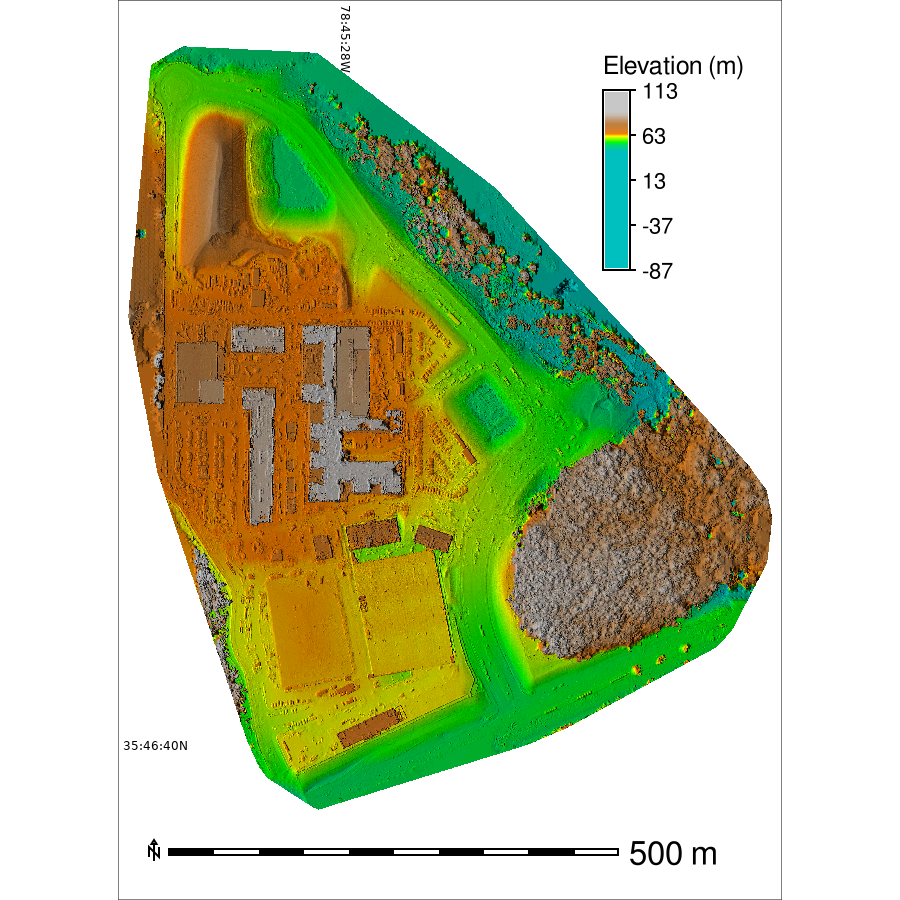

In [97]:
%autoreload 2
import rapid_dem as rd
import importlib
importlib.reload(rd)
gs.run_command("g.region",raster="site_1_dsm_15cm", res=0.15, flags="pa")
gs.run_command("r.colors", map="site_1_dsm_15cm", color="elevation", flags="e")
view_reg = gs.region("site_1_dsm_15cm")
view_reg_n = view_reg['n'] + 50
view_reg_s = view_reg['s'] - 90
gs.run_command("g.region",raster="site_1_dsm_15cm", res=0.15,s=view_reg_s,n=view_reg_n, flags="pa")
rd.generate_uas_elevation_figures(elev="site_1_dsm_15cm", filename="site_1_dsm_15cm_shaded_relief")

#### Figure: DTM 15cm

Image Save Location: output/site_1_dtm_15cm_shaded_relief.png


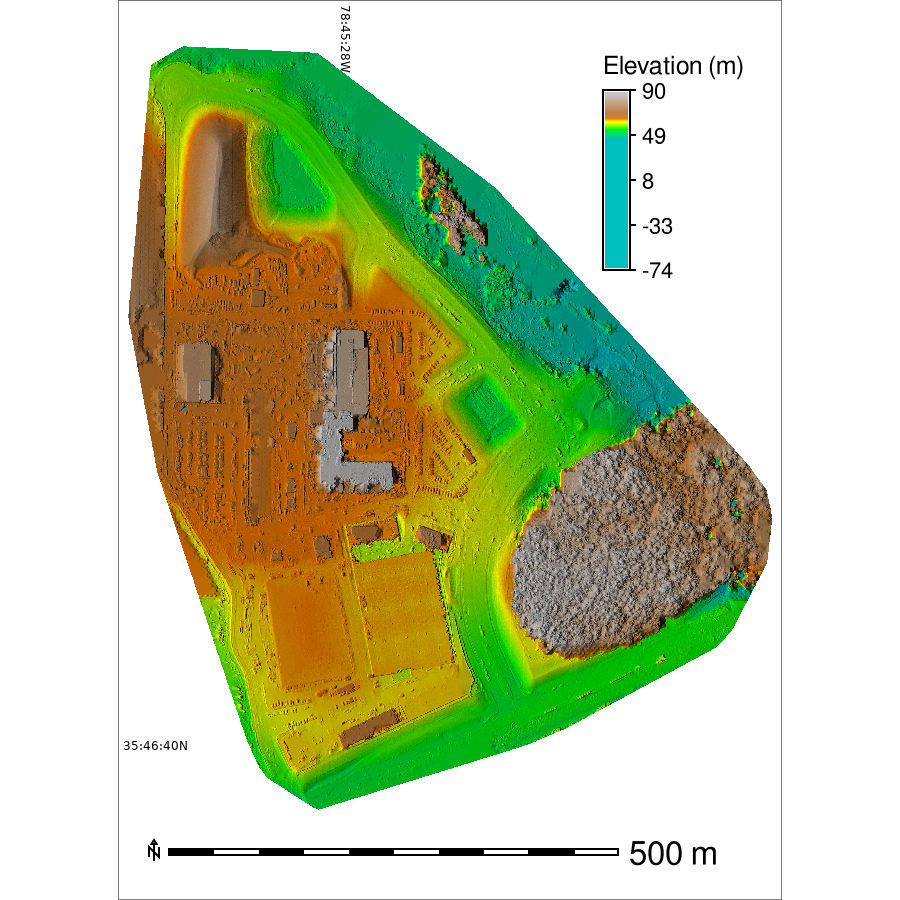

In [98]:
gs.run_command("g.region",raster="site_1_dtm_15cm", res=0.15, flags="pa")
view_reg = gs.region("fenton_odm_dtm_5cm")
view_reg_n = view_reg['n'] + 50
view_reg_s = view_reg['s'] - 90
gs.run_command("g.region",raster="site_1_dtm_15cm", res=0.15,s=view_reg_s,n=view_reg_n, flags="pa")
rd.generate_uas_elevation_figures(elev="site_1_dtm_15cm", filename="site_1_dtm_15cm_shaded_relief")


#### Figure: Ortho 15cm

Image Save Location: output/site_1_ortho_composite_15cm.png


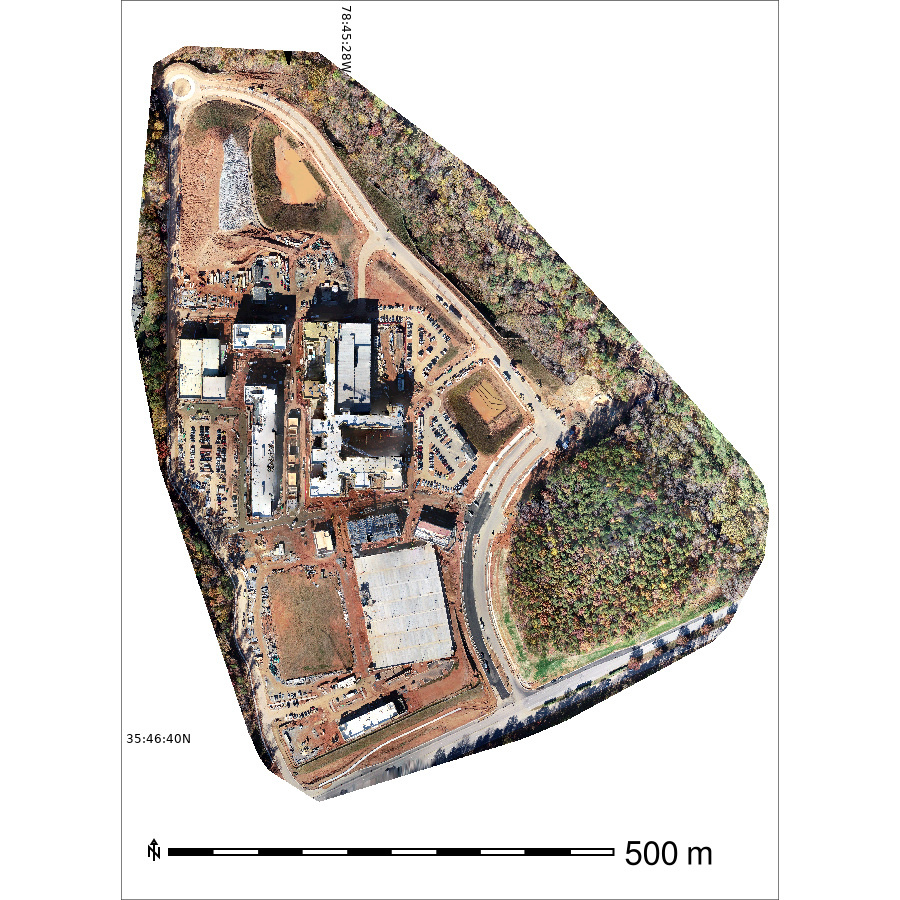

In [99]:
gs.run_command("g.region", raster="site_1_ortho_composite_15cm", res=0.15, flags="ap")
gs.run_command("r.mask",raster="site_1_dsm_15cm",overwrite=True)
view_reg_n = view_reg['n'] + 50
view_reg_s = view_reg['s'] - 100
gs.run_command("g.region",raster="site_1_ortho_composite_15cm",s=view_reg_s, n=view_reg_n, res=0.15, flags="pa")
rd.generate_ortho_figure(ortho="site_1_ortho_composite_15cm", filename="site_1_ortho_composite_15cm")

#### Figure: UAS DEMs Figure

Image Save Location: output/site_1_15cm_shaded_relief.png


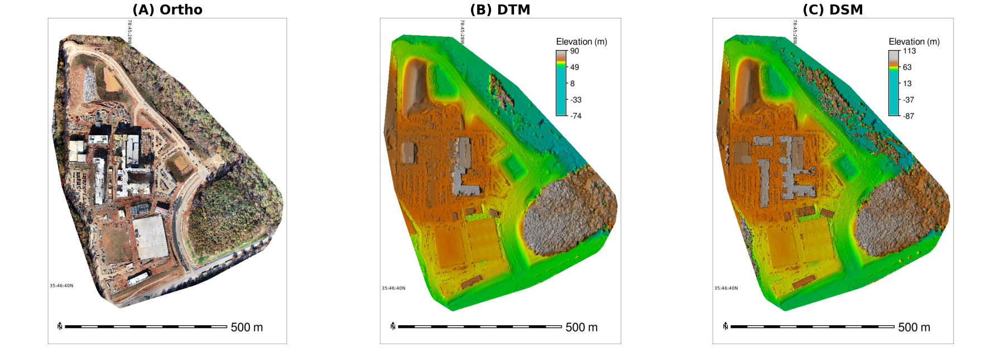

In [100]:
rd.create_flight_figure(
    input_1="site_1_ortho_composite_15cm",
    title_1="(A) Ortho",
    input_2="site_1_dtm_15cm_shaded_relief", 
    title_2="(B) DTM", 
    input_3="site_1_dsm_15cm_shaded_relief", 
    title_3="(C) DSM", 
    filename="site_1_15cm_shaded_relief"
)

Image Save Location: output/priority_queue_elevation_shaded_relief.png


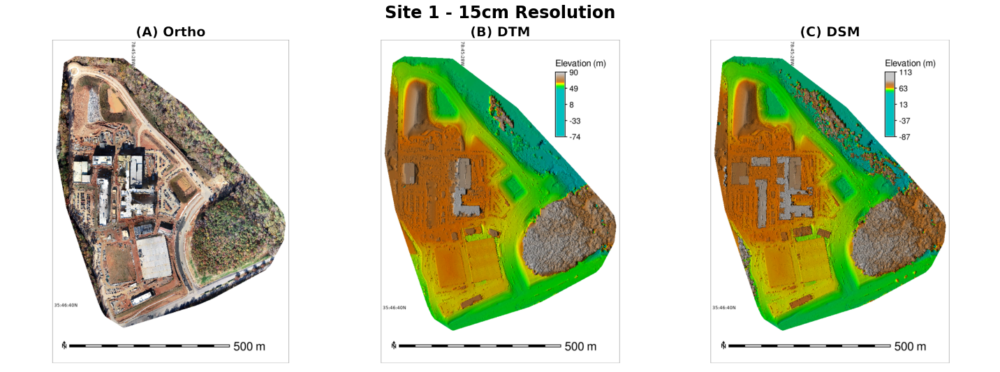

In [101]:
from PIL import Image

fig = plt.figure(figsize=(20, 30))

ax = fig.add_subplot(1, 1, 1)
ax.set_axis_off()

fig.subplots_adjust(hspace=0, wspace=0.1)
# ax.set_axis_off()
img1 = Image.open(f"output/site_1_15cm_shaded_relief.png")
imgplot = plt.imshow(img1)
ax.set_title("Site 1 - 15cm Resolution", {"fontsize":24, "fontweight":"bold"})
output = f"output/priority_queue_elevation_shaded_relief.png"
print(f"Image Save Location: {output}")
    
plt.tight_layout()
plt.savefig(output,bbox_inches='tight',dpi=300)

# Create Bare Earth DEM

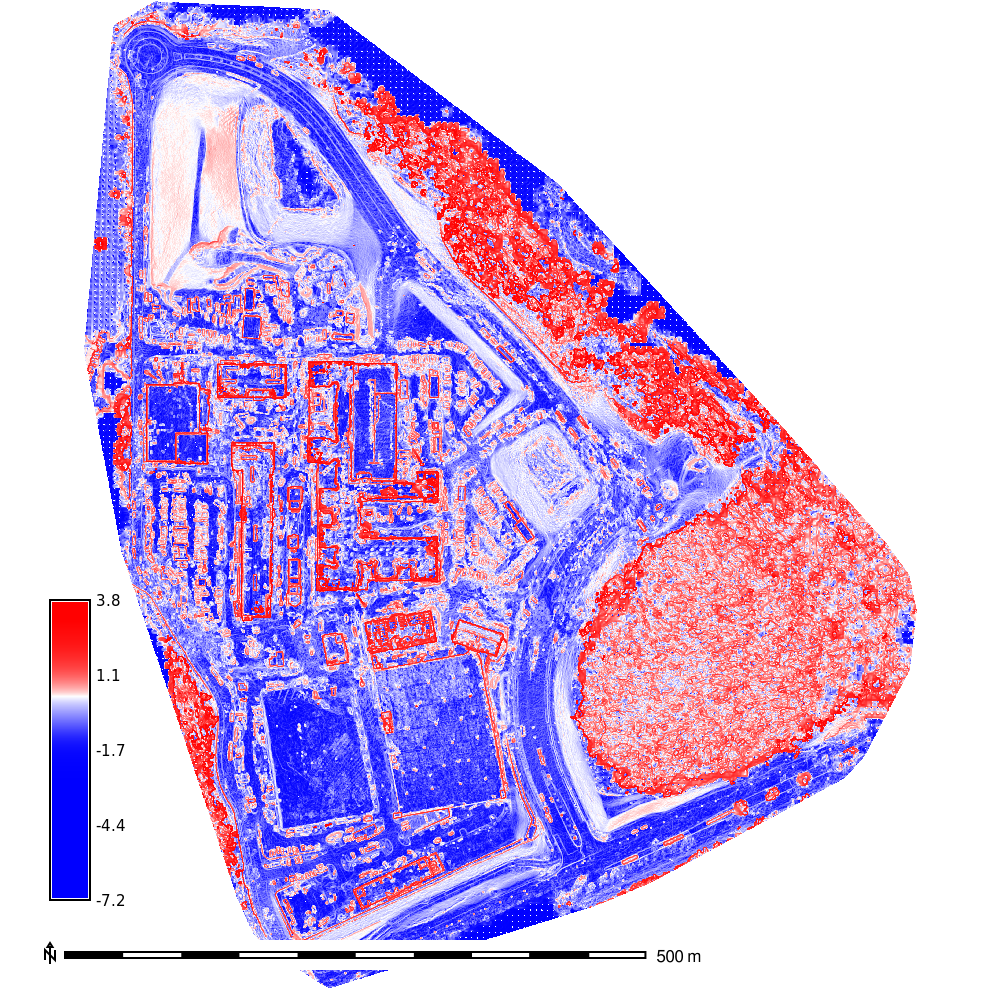

In [102]:
gs.run_command("g.region",raster="site_1_dsm_15cm", res=0.15, flags="pa")
gs.run_command("r.neighbors", overwrite=True, input="site_1_dsm_15cm", output="site_1_dtm_3m_hd_large_tall_objects", method="stddev", size=7)
rd.zscore("site_1_dtm_3m_hd_large_tall_objects","site_1_dtm_3m_hd_log_zscore",log=True)
gs.run_command("r.colors", 
               map="site_1_dtm_3m_hd_log_zscore", 
               color="difference", flags="e", overwrite=True)
gs.mapcalc(f"site_1_dsm_15cm.1 = if(site_1_dtm_3m_hd_log_zscore < 0.5, site_1_dsm_15cm, null())")
gs.run_command("r.colors", 
               map="site_1_dsm_15cm.1", 
               color="elevation", flags="e", overwrite=True)
fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=1000,width=1000, filename="output/site_1_dsm_15cm.1.zscore.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="site_1_dtm_3m_hd_log_zscore")
fenton_bare_earth_fused_diff_map.d_legend(raster="site_1_dtm_3m_hd_log_zscore", at=(10,40,5,9))


fenton_bare_earth_fused_diff_map.d_barscale(at=(4,6), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

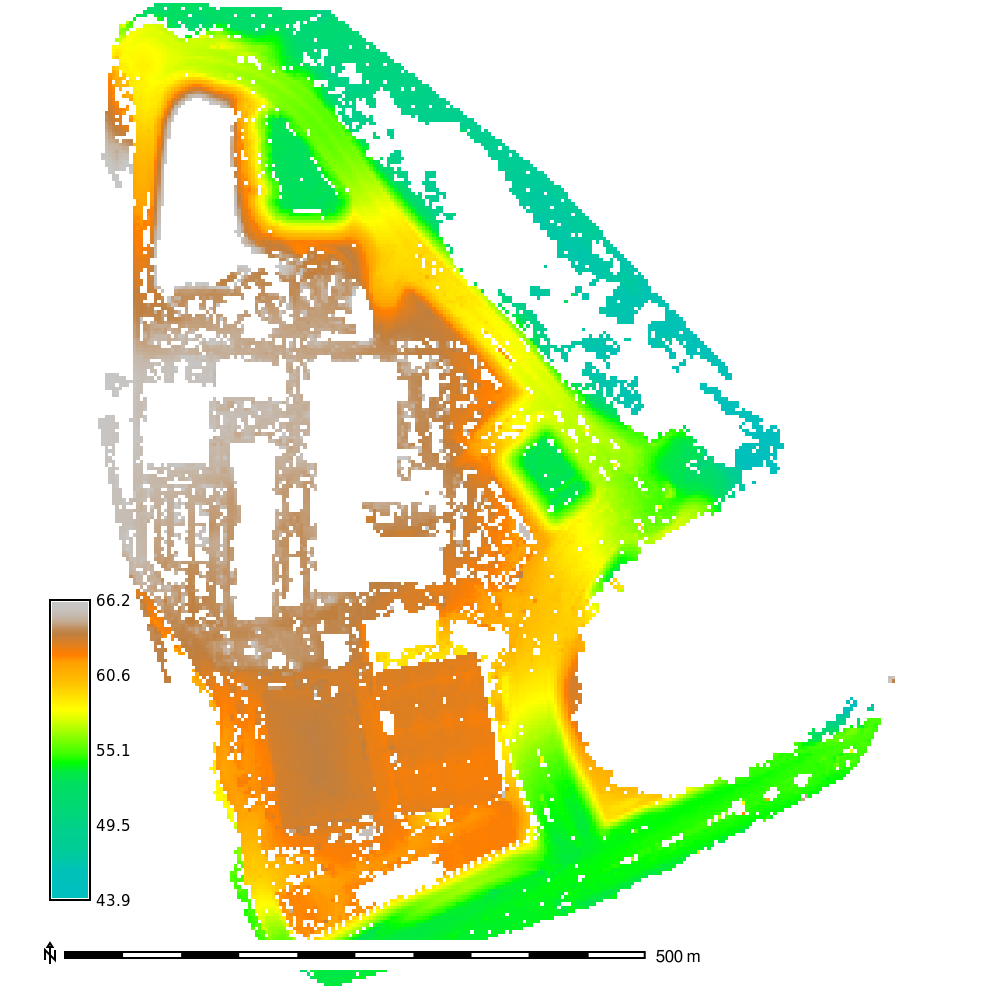

In [103]:
rd.zscore("site_1_dsm_15cm.1","site_1_dsm_15cm.1_log_zscore", log=False)
gs.run_command("r.colors", 
               map="site_1_dsm_15cm.1_log_zscore", 
               color="difference", flags="e", overwrite=True)

gs.mapcalc(f"site_1_dsm_15cm.2 = if(site_1_dsm_15cm.1_log_zscore < 0.4, site_1_dsm_15cm, null())")
gs.run_command("r.colors", 
               map="site_1_dsm_15cm.2", 
               color="elevation", flags="e", overwrite=True)

gs.run_command("r.neighbors", overwrite=True, input="site_1_dsm_15cm.2", output="site_1_dsm_15cm.2.count", method="count", size=3)
gs.mapcalc(f"site_1_dsm_15cm_be = if(site_1_dsm_15cm.2.count > 3, site_1_dsm_15cm, null())")
gs.run_command("g.region",raster="site_1_dsm_15cm", res=3, flags="pa")
gs.run_command("r.resamp.interp", input="site_1_dsm_15cm_be", output="site_1_dsm_3m_be", overwrite=True)

gs.run_command("r.colors", 
               map="site_1_dsm_3m_be", 
               color="elevation", flags="e", overwrite=True)


gs.run_command("r.neighbors", overwrite=True, input="site_1_dsm_3m_be", output="site_1_dsm_3m_be_count", method="count", size=3)
gs.mapcalc(f"site_1_dsm_3m_be_clean = if(site_1_dsm_3m_be_count > 3,site_1_dsm_3m_be, null())")
gs.run_command("r.colors", 
               map="site_1_dsm_3m_be_clean", 
               color="elevation", flags="e", overwrite=True)
fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=1000,width=1000,filename="output/site_1_dsm_3m_be_clean.png")
fenton_bare_earth_fused_diff_map.d_erase()

fenton_bare_earth_fused_diff_map.d_rast(map="site_1_dsm_3m_be_clean"
                                        # , values="1-2"
                                       )

fenton_bare_earth_fused_diff_map.d_legend(raster="site_1_dsm_3m_be_clean",at=(10,40,5,9))

fenton_bare_earth_fused_diff_map.d_barscale(at=(4,6), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

## Mask Vegetation

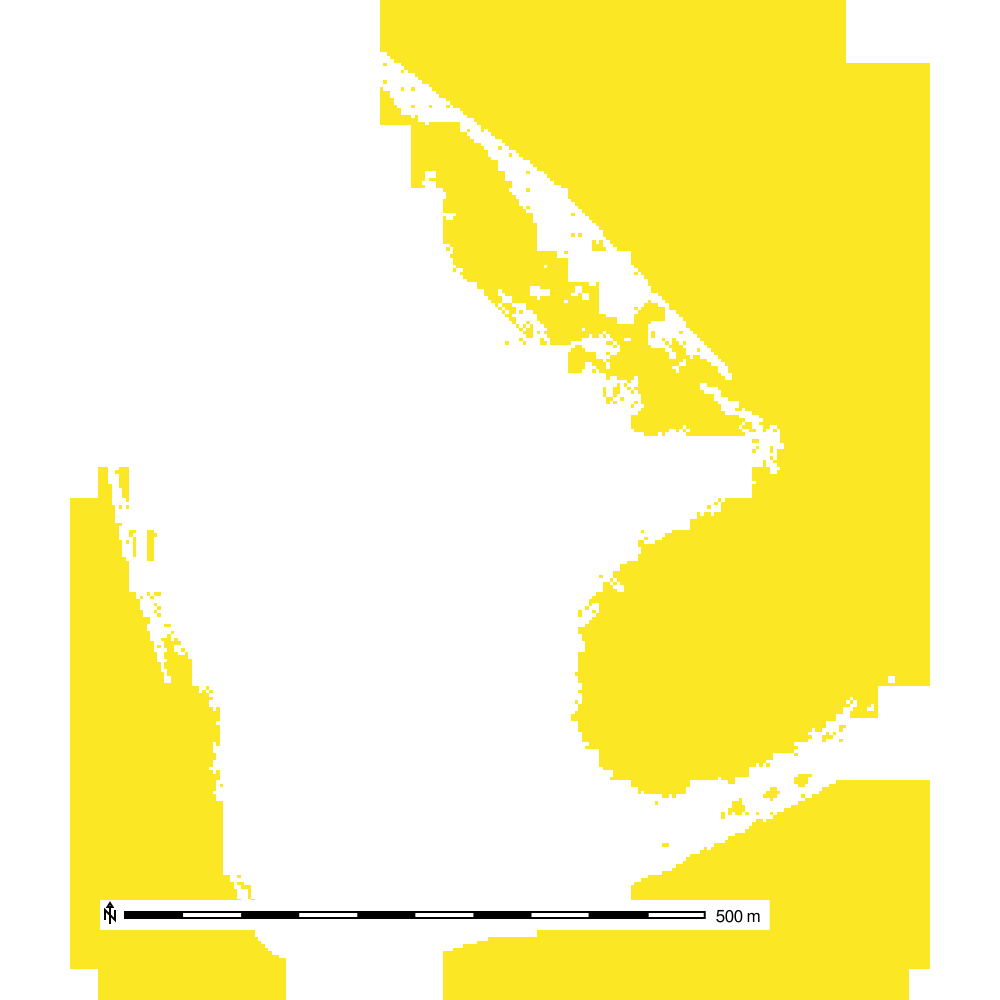

In [104]:
gs.run_command("g.region",raster="site_1_dsm_15cm", res=3, flags="pa")
gs.run_command("r.mask",raster="site_1_dsm_3m_be_clean",flags="i", overwrite=True)

gs.run_command("r.neighbors", overwrite=True, input="classified_after_30m_recl", output="classified_after_30m_recl_mode,site_1_3m_hd_bai_zscore_count", method="mode,count", size=3)
gs.mapcalc(f"site_1_dsm_3m_be_veg_build = if(site_1_3m_hd_bai_zscore_count > 4 && classified_after_30m_recl_mode == 3,1, null())")
gs.run_command("r.mask",flags="r")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=1000,width=1000)
fenton_bare_earth_fused_diff_map.d_erase()
# fenton_bare_earth_fused_diff_map.d_rast(map="classified_after_30m_recl_mode")
# fenton_bare_earth_fused_diff_map.d_rast(map="site_1_3m_hd_bai_zscore_count")
fenton_bare_earth_fused_diff_map.d_rast(map="site_1_dsm_3m_be_veg_build")

# fenton_bare_earth_fused_diff_map.d_legend(raster="site_1_dsm_3m_be_veg_build")

fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

## Smooth DEM and Fill Holes

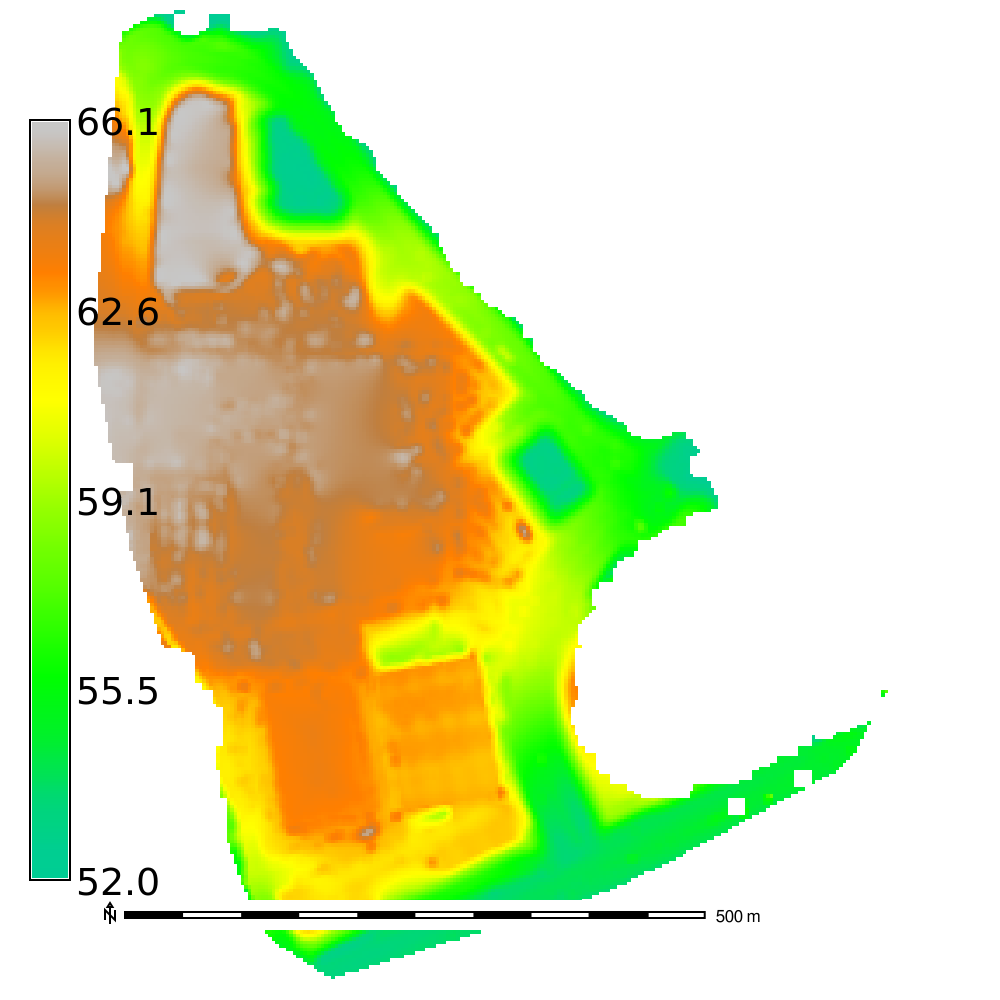

In [105]:
gs.run_command("r.mask",raster="site_1_dsm_15cm")

# Fill holes where buildings are missing but not in large forested areas
gs.run_command("r.fillnulls", input="site_1_dsm_3m_be_clean", output="ready_dem_3m", tension=100,smooth=1,memory=10000)


gs.mapcalc(f"ready_to_fuse = if(isnull(site_1_dsm_3m_be_veg_build),ready_dem_3m, null())")

# Remove remaining low lining forested areas and smooth dem
gs.mapcalc(f"ready_to_fuse_smooth1 = if(ready_to_fuse >= 52, ready_to_fuse,null())") #52
gs.run_command("r.neighbors", overwrite=True, input="ready_to_fuse_smooth1", output="ready_to_fuse_smooth2", method="average", size=3)

# Decrease noise in the DEM by removing cells that don't meet the neighbor threshold.
gs.run_command("r.neighbors", overwrite=True, input="ready_to_fuse_smooth2", output="ready_to_fuse_smooth2_count", method="count", size=5)
gs.mapcalc(f"ready_to_fuse_smooth = if(ready_to_fuse_smooth2_count >= 25,ready_to_fuse_smooth2, null())") #25

gs.run_command("r.colors", 
               map="ready_to_fuse,ready_to_fuse_smooth", 
               color="elevation", flags="e", overwrite=True)
gs.run_command("r.mask",flags="r")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=1000,width=1000)
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="ready_to_fuse_smooth")
fenton_bare_earth_fused_diff_map.d_legend(raster="ready_to_fuse_smooth")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

#### Figure: DSM to DEM processing

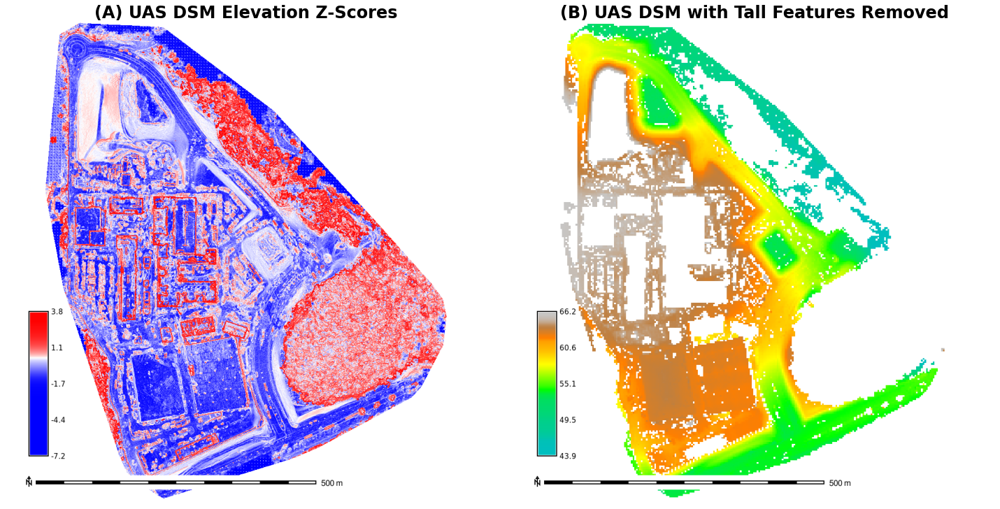

In [106]:
from PIL import Image

fig = plt.figure(figsize=(20, 10),constrained_layout=True)
ax.set_title("Site 1 - 5cm Resolution", {"fontsize":24, "fontweight":"bold"})

grs = fig.add_gridspec(1, 2)

ax = fig.add_subplot(grs[0,0])
ax.set_axis_off()
# fig.subplots_adjust(hspace=0, wspace=0.0)
img = Image.open("output/site_1_dsm_15cm.1.zscore.png")
imgplot = plt.imshow(img)
ax.set_title('(A) UAS DSM Elevation Z-Scores',{"fontsize":24, "fontweight":"bold"})

ax1 = fig.add_subplot(grs[0, 1])
ax1.set_axis_off()
# fig.subplots_adjust(hspace=0, wspace=0.0)
img1 = Image.open("output/site_1_dsm_3m_be_clean.png")
imgplot = plt.imshow(img1)
ax1.set_title('(B) UAS DSM with Tall Features Removed',{"fontsize":24, "fontweight":"bold"})

plt.savefig("output/bare_earth_dem_process.png",bbox_inches='tight', dpi=300)

#### Figure: UAS DEM

Image Save Location: output/ready_to_fuse_smooth_shaded_relief.png


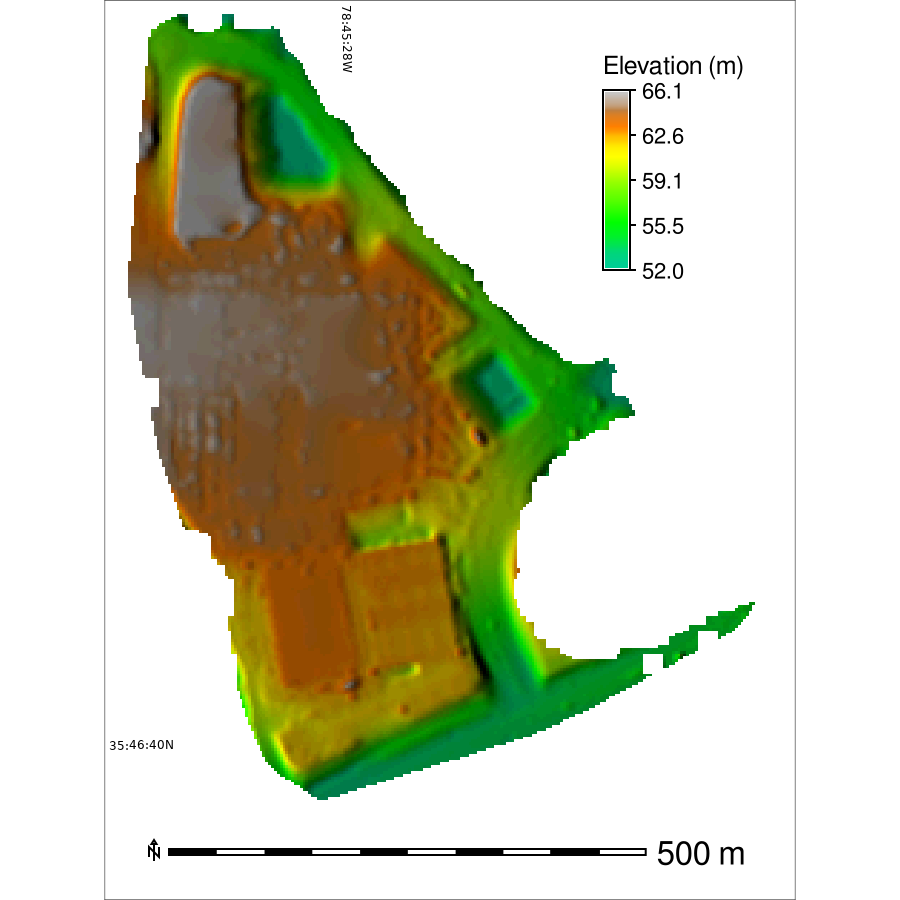

In [107]:
gs.run_command("g.region",raster="ready_to_fuse_smooth", res=3, flags="pa")
view_reg = gs.region("ready_to_fuse_smooth")
view_reg_e = view_reg['e'] - 20
view_reg_s = view_reg['s'] - 80
gs.run_command("g.region",raster="ready_to_fuse_smooth", e=view_reg_e,s=view_reg_s, res=3, flags="pa")

# gs.run_command("r.mask",raster="cary_town_blvd_flight_1_odm_dsm_3m",overwrite=True)
rd.generate_uas_elevation_figures(elev="ready_to_fuse_smooth", filename="ready_to_fuse_smooth_shaded_relief")

# Calculate Vertical Offset

In [110]:
gs.run_command("g.region",raster="site_1_dsm_3m_hd", res=3, flags="pa")

pcoords = "631570.5318973756,224934.1825294847,632046.908163902,225153.77865823693"
df_ned = rd.profile_dem("ned_19sec_site_priority_1","ned_19sec_3m_profile",pcoords)
df_uas = rd.profile_dem("site_1_dsm_3m_hd","site_1_dsm_3m_profile",pcoords)
df_ned['DEMs'] = "A) USGS NED DEM"
df_uas['DEMs'] = "B) UAS DSM"
df_uas = df_uas[df_uas['diff'] > 0]
df_profiles = pd.concat([df_ned, df_uas], ignore_index=True)
df_profiles.head()
df_profiles.groupby(by=["DEMs"]).describe()

df_pivot = df_profiles.pivot(index="profile", columns="DEMs", values="diff").dropna(axis='rows')
df_pivot['shift'] = df_pivot.apply(lambda x:x['A) USGS NED DEM'] - x['B) UAS DSM'], axis=1)
VERT_OFFSET = df_pivot['shift'].describe()['50%'] * -1
print(f"Vertical Offset: {VERT_OFFSET}")

Vertical Offset: -79.8853165


# Fuse UAS DEM with USGS NED DEM

## Fuse UAS DEM and USGS NED DEM

In [112]:
gs.run_command("g.region",raster="site_1_dsm_3m_hd", res=3, flags="pa")

rd.fusion(
    dem="ned_19sec_site_priority_1",
    uas="ready_to_fuse_smooth",
    output="fenton_bare_earth_fused",
    ps=13,ta=30,dr=9,
    usgs=False,
    offset_value=VERT_OFFSET
)

gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.mapcalc("bare_earth_smooth_thin = fenton_bare_earth_fused_vertically_corrected_uas")

######################### Geographic Shift #########################
Inputs: dem:ready_to_fuse_smooth,output: geo_correct_uas,row_shift: 0, column_shift: 0
######################### Resample #########################
Output Raster: Resampled to Match UAS: tmp_resampled
######################### Get Diff #########################
Output Raster: Difference (UAS - DEM): fenton_bare_earth_fused_diff
Difference: Mean:-79.8940688495257, STD: 2.87409843686259, Median: -79.8938
Range: Min:-87.9435847600325, Max: -66.7714138031006
Vertical shift is likely.
######################### Vertical Correction #########################
Shifting geo_correct_uas by -79.8938m
Output: Vertically Corrected UAS (UAS - Shift): fenton_bare_earth_fused_vertically_corrected_uas
Vertically Corrected Stats: Mean: 141.082573888739, STD: 3.8383829732283, Median: 142.561
Output: Difference (Vertically Corrected UAS - DEM): fenton_bare_earth_fused_diff_corrected
Difference (Vertically Corrected UAS - DEM) Stats: Mean: 

#### Fused DEM

Image Save Location: output/fenton_bare_earth_shaded_relief.png


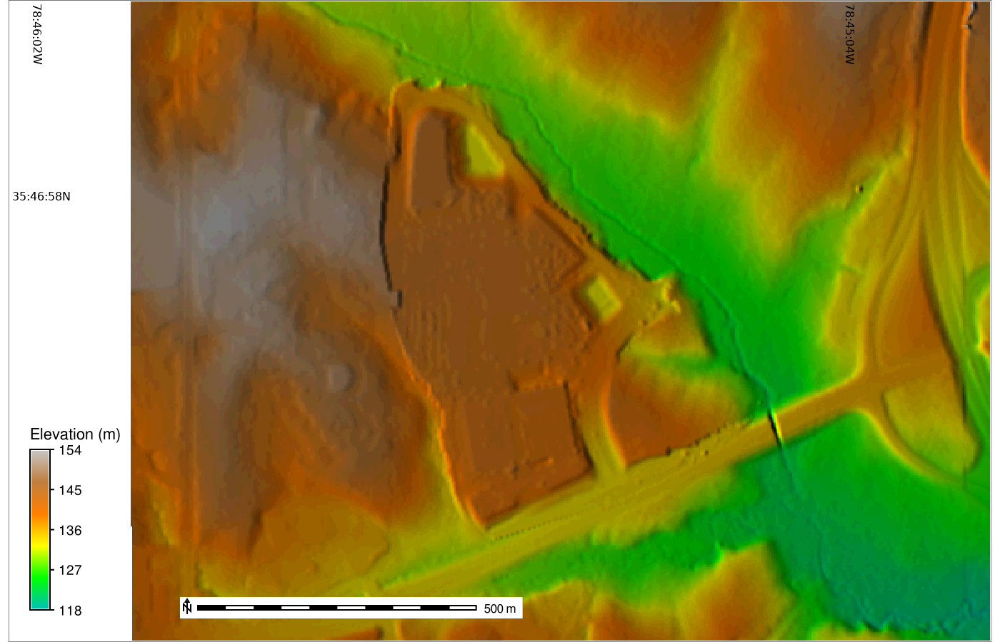

In [115]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")

view_reg = gs.region("site_1")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 150

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               res=3, flags="pa")

rd.generate_fusion_elevation_figure(elev="fenton_bare_earth_fused", filename="fenton_bare_earth_shaded_relief")

#### USGS DEM

Image Save Location: output/ned_19sec_site_priority_1_shaded_relief.png


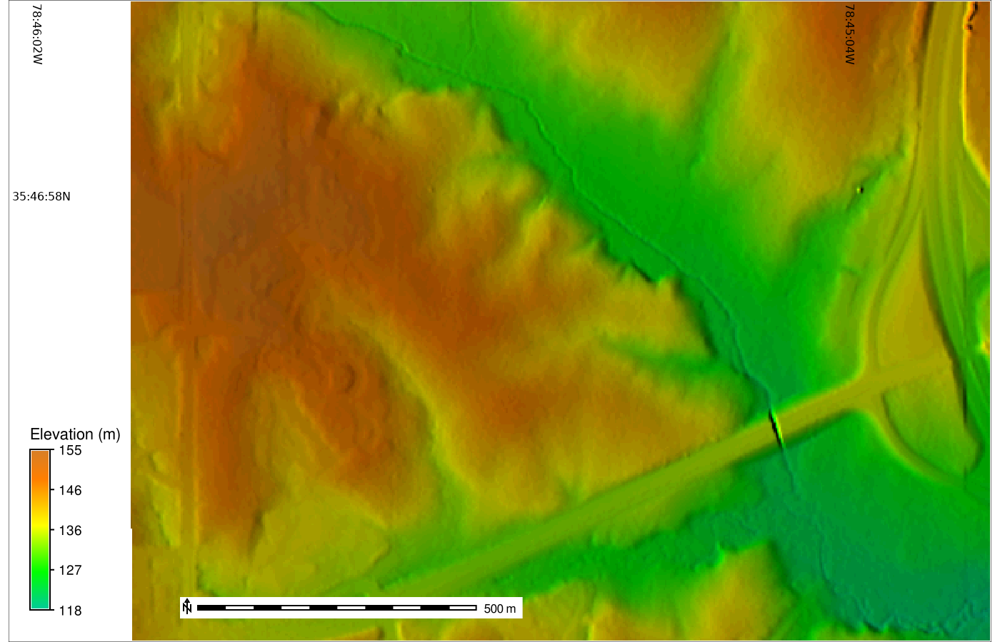

In [116]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 150

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               res=3, flags="pa")
rd.generate_fusion_elevation_figure(elev="ned_19sec_site_priority_1", filename="ned_19sec_site_priority_1_shaded_relief")

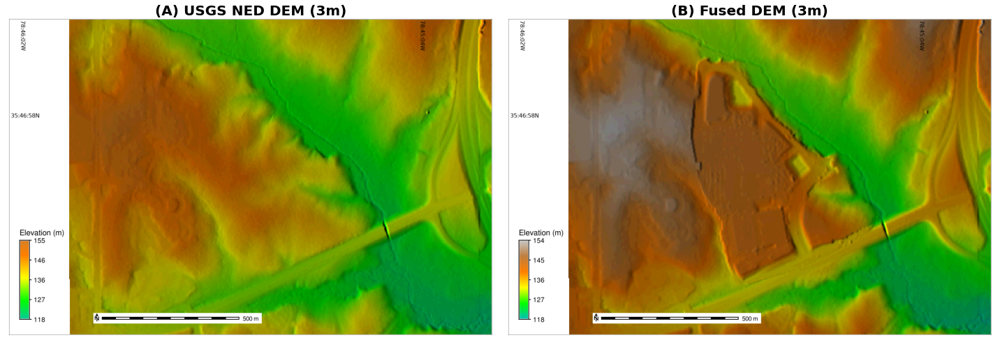

In [117]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img_ortho = Image.open("output/ned_19sec_site_priority_1_shaded_relief.png")
imgplot = plt.imshow(img_ortho)
ax.set_title('(A) USGS NED DEM (3m)',{"fontsize":20, "fontweight":"bold"})

ax = fig.add_subplot(1, 2, 2)
ax.set_axis_off()
img1 = Image.open("output/fenton_bare_earth_shaded_relief.png")
imgplot = plt.imshow(img1)
ax.set_title('(B) Fused DEM (3m)',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/cary_town_blvd_dtm_3m_fusion.png",bbox_inches='tight', dpi=300)

#### Fusion Boundary

In [118]:
gs.mapcalc("fusion_boundary = if(!isnull(ready_to_fuse_smooth), 1, null())")
gs.run_command("g.region",region="site_1", res=0.5, flags="pa")
gs.run_command("r.to.vect", flags="s",input="fusion_boundary", output="fusion_boundary", type="area") #ready_to_fuse_smooth

### Variable Overlap

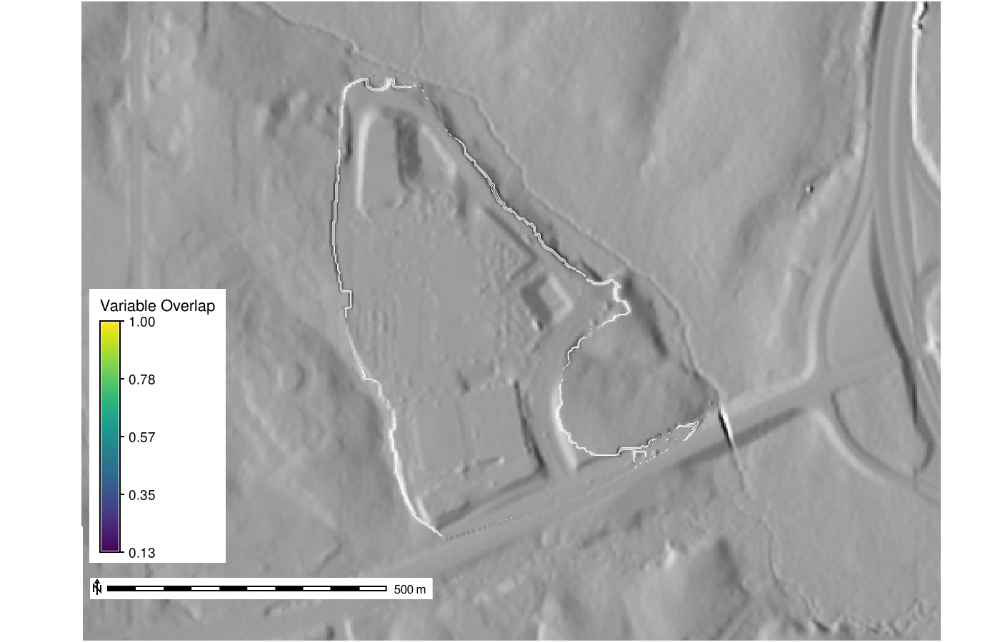

In [119]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_fused_overlap", output="fenton_bare_earth_fused_overlap_shaded_relief", overwrite=True)
gs.run_command("r.contour",overwrite=True, input="fenton_bare_earth_fused_overlap", output="fenton_bare_earth_fused_overlap_contours",step=0.2)
fenton_bare_earth_fused_overlap_map = gj.GrassRenderer(height=900, width=1400, filename="output/fenton_bare_earth_fused_overlap.png")
fenton_bare_earth_fused_overlap_map.d_erase()
fenton_bare_earth_fused_overlap_map.d_rast(map="fenton_bare_earth_fused_relief")
# fenton_bare_earth_fused_overlap_map.d_rast(map="fenton_bare_earth_fused_overlap_shaded_relief")
fenton_bare_earth_fused_overlap_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="white", width="0.5", legend_label="Variable Overlap")
fenton_bare_earth_fused_overlap_map.d_legend(raster="fenton_bare_earth_fused_overlap",
                                             # label_values="0.2,0.4,0.6,0.8", labelnum=5,
                                             at=(14,50,10,12),
                                             title="Variable Overlap", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="bt")
fenton_bare_earth_fused_overlap_map.d_barscale(at=(9,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_overlap_map.show()

### Slopes

#### USGS Slope

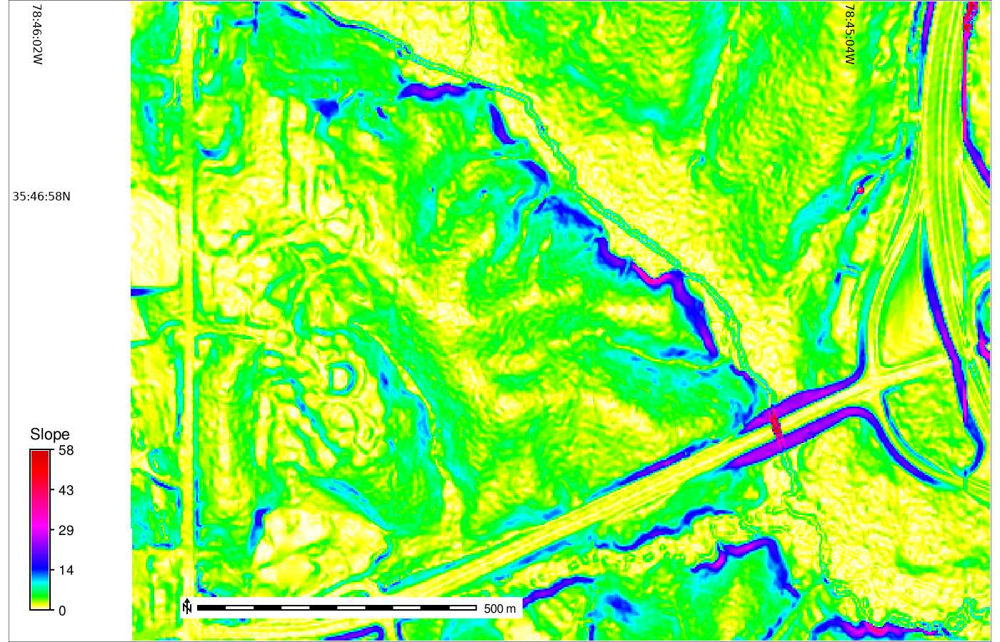

In [120]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.slope.aspect", elevation="ned_19sec_site_priority_1", slope="ned_19sec_site_priority_1_3m_slope_3m", aspect="ned_19sec_site_priority_1_3m_aspect_3m", overwrite=True)
view_reg = gs.region("site_1")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 150

gs.run_command("g.region",
               region="site_1",
               # n=view_reg_n,
               w=view_reg_w,
               # e=view_reg_e,
               # s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")
ned_19sec_site_priority_1_3m_slope_3m_map = gj.GrassRenderer(height=900, width=1400,filename="output/ned_19sec_site_priority_1_3m_slope_3m_slope.png")
ned_19sec_site_priority_1_3m_slope_3m_map.d_erase()
ned_19sec_site_priority_1_3m_slope_3m_map.d_rast(map="ned_19sec_site_priority_1_3m_slope_3m")


ned_19sec_site_priority_1_3m_slope_3m_map.d_legend(raster="ned_19sec_site_priority_1_3m_slope_3m", at=(5,30,3,5),
                      title="Slope",font="FreeSans", border_color="none",
                      title_fontsize=16, fontsize=14, 
                      flags="bt")
ned_19sec_site_priority_1_3m_slope_3m_map.d_barscale(at=(18,7), units="meters", flags="n",font="FreeSans")
ned_19sec_site_priority_1_3m_slope_3m_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)
ned_19sec_site_priority_1_3m_slope_3m_map.show()

#### Fused Slope

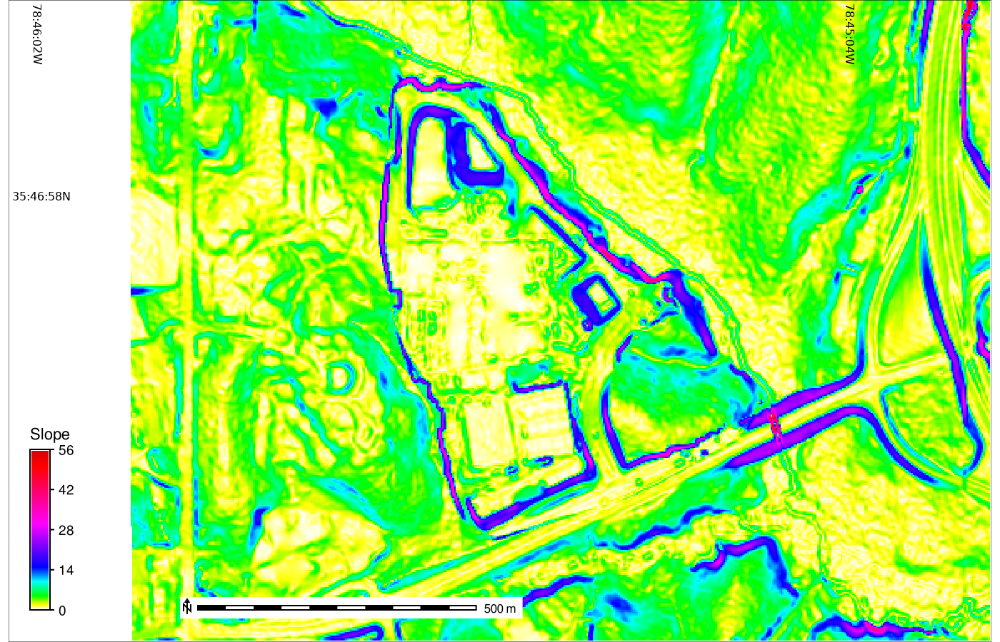

In [122]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.slope.aspect", elevation="fenton_bare_earth_fused", slope="fenton_bare_earth_fused_slope_3m", aspect="fenton_bare_earth_fused_aspect_3m", overwrite=True)
view_reg = gs.region("site_1")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 150

gs.run_command("g.region",
               region="site_1",
               # n=view_reg_n,
               w=view_reg_w,
               # e=view_reg_e,
               # s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")
fenton_fused_f1_3m_slope_3m_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_fused_f1_3m_slope_3m_slope.png")
fenton_fused_f1_3m_slope_3m_map.d_erase()
fenton_fused_f1_3m_slope_3m_map.d_rast(map="fenton_bare_earth_fused_slope_3m")

fenton_fused_f1_3m_slope_3m_map.d_legend(raster="fenton_bare_earth_fused_slope_3m", at=(5,30,3,5),
                      title="Slope",font="FreeSans", border_color="none",
                      title_fontsize=16, fontsize=14, 
                      flags="bt")
fenton_fused_f1_3m_slope_3m_map.d_barscale(at=(18,7), units="meters", flags="n",font="FreeSans")
fenton_fused_f1_3m_slope_3m_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)
fenton_fused_f1_3m_slope_3m_map.show()

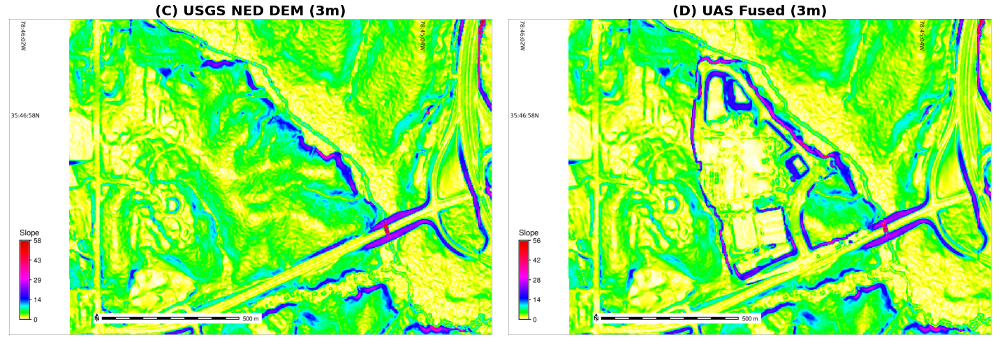

In [123]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img1 = Image.open("output/ned_19sec_site_priority_1_3m_slope_3m_slope.png")
imgplot = plt.imshow(img1)
ax.set_title('(C) USGS NED DEM (3m)',{"fontsize":20, "fontweight":"bold"})

ax = fig.add_subplot(1, 2, 2)
ax.set_axis_off()
img2 = Image.open("output/fenton_fused_f1_3m_slope_3m_slope.png")
imgplot = plt.imshow(img2)
ax.set_title('(D) UAS Fused (3m)',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/fenton_fusion_slope_fig.png",bbox_inches='tight',dpi=300)

### Figure: DEM and Slope

Image Save Location: output/feton_geomorphology_fig.png


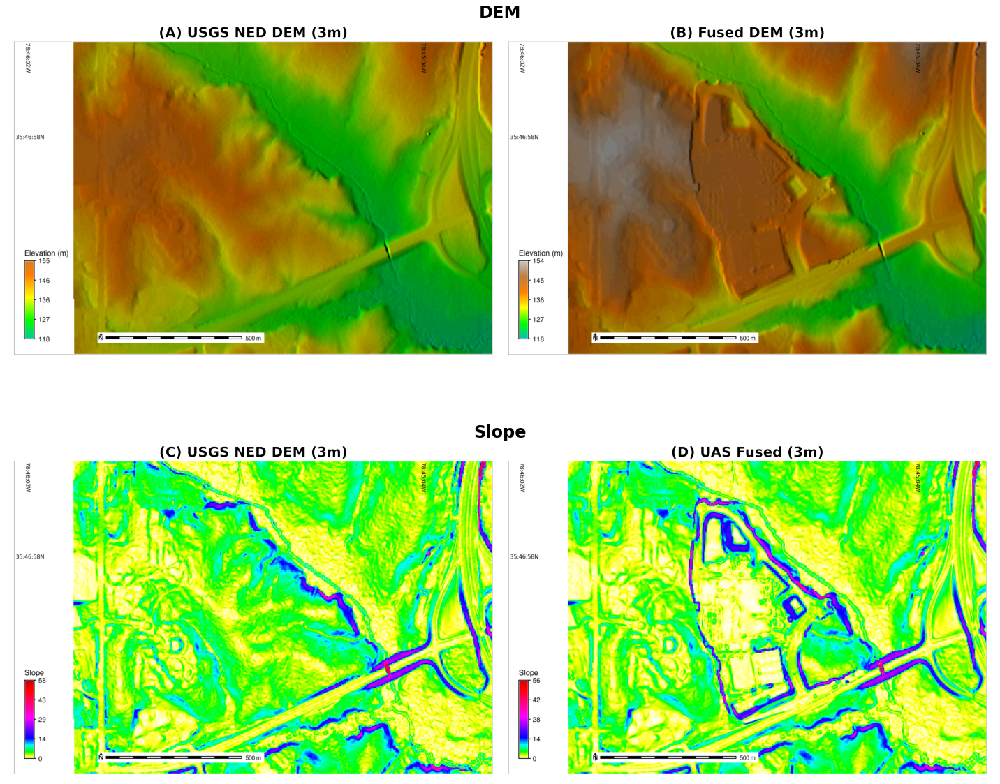

In [124]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(2, 1, 1)
ax.set_axis_off()
fig.subplots_adjust(hspace=0, wspace=0.1)
    # ax.set_axis_off()
img1 = Image.open(f"output/cary_town_blvd_dtm_3m_fusion.png")
imgplot = plt.imshow(img1)
ax.set_title("DEM", {"fontsize":24, "fontweight":"bold"})

ax = fig.add_subplot(2, 1, 2)
ax.set_axis_off()
img2 = Image.open(f"output/fenton_fusion_slope_fig.png")
imgplot = plt.imshow(img2)
ax.set_title("Slope", {"fontsize":24, "fontweight":"bold"})
    
output = f"output/feton_geomorphology_fig.png"
print(f"Image Save Location: {output}")
    
plt.tight_layout()
plt.savefig(output,bbox_inches='tight',dpi=300)

#### Difference (Fused Slope - USGS Slope)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 6854

Of the non-null cells:
----------------------
n: 195898
minimum: -32.6791
maximum: 33.7891
range: 66.4682
mean: 0.0140536
mean of absolute values: 1.25773
standard deviation: 2.93342
variance: 8.60493
variation coefficient: 20873 %
sum: 2753.07886056229
1st quartile: -0.540262
median (even number of cells): -0.0727102
3rd quartile: 0.299185
90th percentile: 0.991218


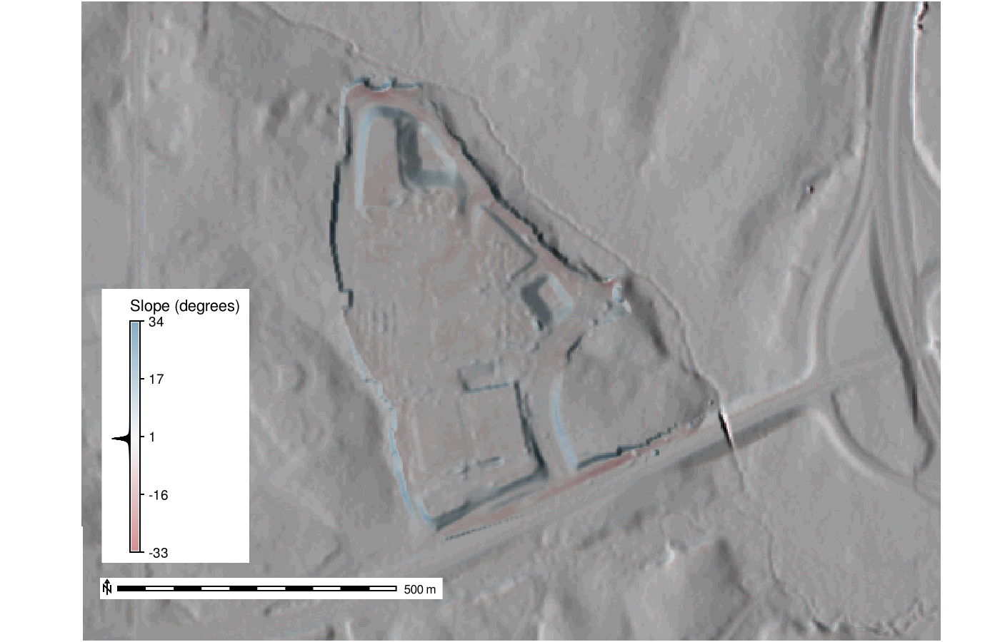

In [126]:
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.mapcalc("diff_slope_fused_dem_usgs_dem = fenton_bare_earth_fused_slope_3m - ned_19sec_site_priority_1_3m_slope_3m")
gs.run_command("r.colors",map="diff_slope_fused_dem_usgs_dem", rules="grass_config/diff_slope_color.txt", flags="n")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="diff_slope_fused_dem_usgs_dem", output="diff_slope_fused_dem_usgs_dem_shaded_relief", overwrite=True)

# fenton_bare_earth_fused
!r.univar diff_slope_fused_dem_usgs_dem -e

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/diff_slope_fused_dem_usgs_dem.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map="diff_slope_fused_dem_usgs_dem_shaded_relief")
fenton_bare_earth_fused_diff_map.d_legend(raster="diff_slope_fused_dem_usgs_dem",
                                             at=(14,50,13,14),
                                             title="Slope (degrees)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

### Absolute Difference (USGS and Fusion)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 327714
total null cells: 297588

Of the non-null cells:
----------------------
n: 30126
minimum: 0.000171736
maximum: 8.26083
range: 8.26066
mean: 2.3242
mean of absolute values: 2.3242
standard deviation: 1.59711
variance: 2.55078
variation coefficient: 68.7168 %
sum: 70018.8187675757
1st quartile: 0.974237
median (even number of cells): 2.09135
3rd quartile: 3.49853
90th percentile: 4.50506


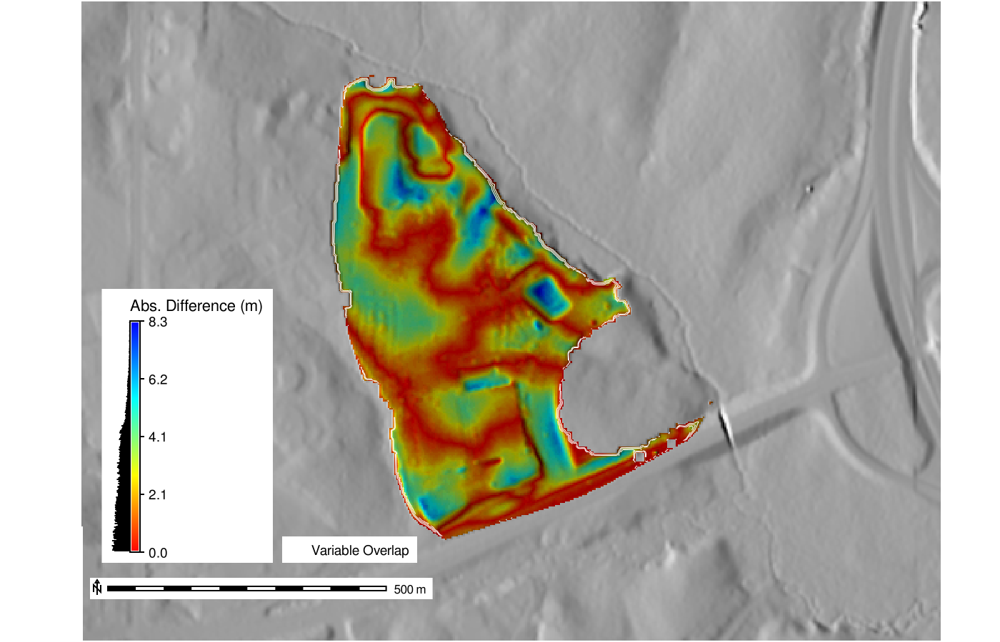

In [128]:
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.mapcalc(f"fenton_bare_earth_fused_abs_diff = if(bare_earth_smooth_thin,abs(fenton_bare_earth_fused - ned_19sec_site_priority_1), null())")

gs.run_command("r.colors",map="fenton_bare_earth_fused_abs_diff", color="bcyr", flags="n")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_fused_abs_diff", output="fenton_bare_earth_fused_abs_diff_shaded_relief", overwrite=True)
!r.univar fenton_bare_earth_fused_abs_diff -e
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fenton_bare_earth_fused_abs_diff_map = gj.GrassRenderer(height=900,width=1400,filename="output/fenton_bare_earth_fused_abs_diff.png")
fenton_bare_earth_fused_abs_diff_map.d_erase()
fenton_bare_earth_fused_abs_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_abs_diff_map.d_rast(map="fenton_bare_earth_fused_abs_diff_shaded_relief")
fenton_bare_earth_fused_abs_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="white", width="0.5", legend_label="Variable Overlap")

fenton_bare_earth_fused_abs_diff_map.d_legend_vect(at=(29,16.25),font="FreeSans", flags="b",border_color="none")
fenton_bare_earth_fused_abs_diff_map.d_legend(raster="fenton_bare_earth_fused_abs_diff",
                                             at=(14,50,13,14),
                                             title="Abs. Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_abs_diff_map.d_barscale(at=(9,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_abs_diff_map.show()


### Total Difference (USGS and Fusion)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 172626

Of the non-null cells:
----------------------
n: 30126
minimum: -8.26083
maximum: 7.77904
range: 16.0399
mean: -0.054982
mean of absolute values: 2.3242
standard deviation: 2.81951
variance: 7.94965
variation coefficient: -5128.07 %
sum: -1656.3877755603
1st quartile: -2.15624
median (even number of cells): -0.0353053
3rd quartile: 2.02416
90th percentile: 3.68167


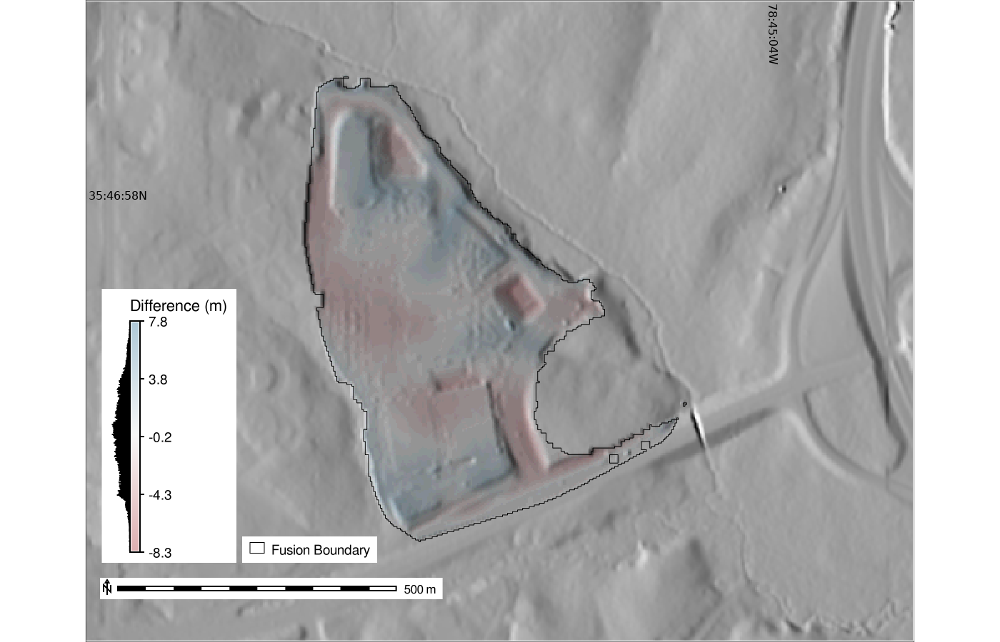

In [129]:

# gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.mask",raster="bare_earth_smooth_thin", overwrite=True)

# Calculated during fusion process (fenton_bare_earth_fused_diff)
gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
gs.run_command("r.colors",map="fenton_bare_earth_fused_diff", rules="grass_config/diff_colors.txt", flags="n")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_fused_diff", output="fenton_bare_earth_fused_diff_shaded_relief", overwrite=True)
# gs.run_command("r.mask",raster="bare_earth_smooth_thin", overwrite=True)
!r.univar fenton_bare_earth_fused_diff -e
gs.run_command("r.mask",flags="r")

gs.run_command("g.region",region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")


view_reg_w = view_reg['w'] + 100
gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               res=3, flags="pa")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_bare_earth_fused_diff.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_diff_shaded_relief")
fenton_bare_earth_fused_diff_map.d_vect(map="fusion_boundary", fill_color="none",color="black", width="0.5", legend_label="Fusion Boundary")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(25,16.25),font="FreeSans", flags="b",border_color="none")

fenton_bare_earth_fused_diff_map.d_legend(raster="fenton_bare_earth_fused_diff",
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)

fenton_bare_earth_fused_diff_map.show()


### Edge (Corrected UAS and USGS DEM)

   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 201553

Of the non-null cells:
----------------------
n: 1199
minimum: -5.76375
maximum: 12.9642
range: 18.7279
mean: 0.623776
mean of absolute values: 2.20152
standard deviation: 2.74386
variance: 7.52876
variation coefficient: 439.879 %
sum: 747.907929977496
1st quartile: -0.663068
median (odd number of cells): 0.769649
3rd quartile: 2.47756
90th percentile: 3.7871
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
total null and non-null cells: 202752
total null cells: 201592

Of the non-null cells:
----------------------
n: 1160
minimum: -5.64301
maximum: 7.79126
range: 13.4343
mean: 0.517218
mean of absolute values: 2.20512
standard deviation: 2.74461
variance: 7.53288
variation coefficient: 530.648

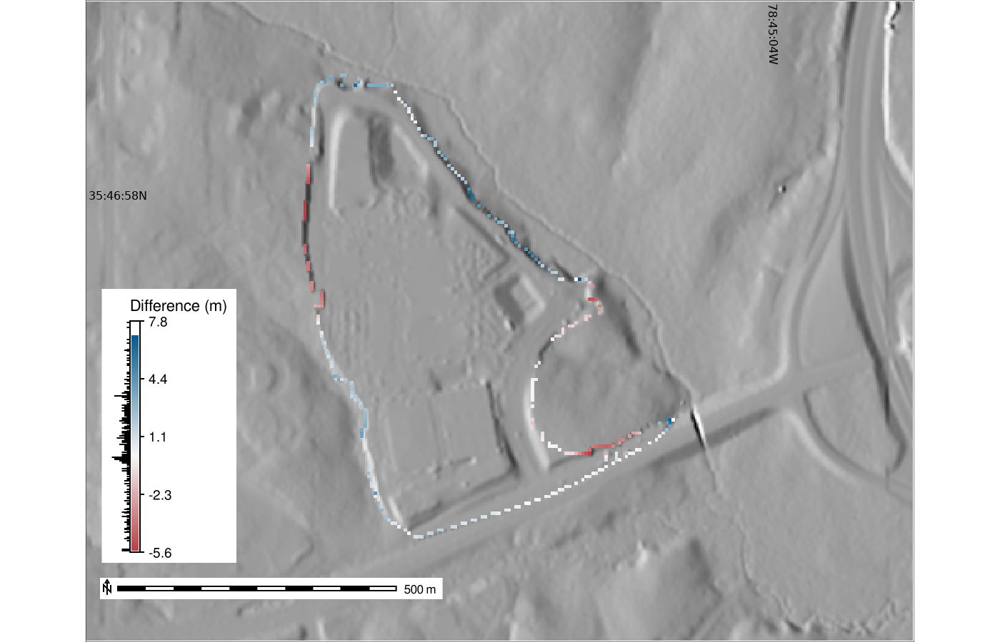

In [130]:
# Generate Edge
# gs.run_command("r.mask",flags="r")
# gs.run_command("r.mask",flags="r")
gs.run_command("g.region",region="site_1", res=3, flags="pa")

# Create mask of UAS bare earth DEM
# gs.mapcalc(f"bare_earth_mask = if(bare_earth_smooth,1,null())")
gs.mapcalc(f"bare_earth_mask = if(bare_earth_smooth_thin,1,null())")
# Create raster of the difference between the Vertically Corrected UAS and USGS NED DEM
# gs.mapcalc(f"fenton_bare_earth_ned_diff = if(bare_earth_mask,bare_earth_smooth - ned_19sec_site_priority_1, null())")
gs.mapcalc(f"fenton_bare_earth_ned_diff = if(bare_earth_mask,bare_earth_smooth_thin - ned_19sec_site_priority_1, null())")

# Create raster 2 pixels smaller than bare earth dem
gs.run_command("r.grow", overwrite=True, input="bare_earth_mask", output="bare_earth_thin_edge", radius=-2)
# Assign int values of UAS - DEM to pixels representing the bare earth dem boarder.
# The raster needs to be of TYPE CELL to work with r.thin below
gs.mapcalc(f"fenton_bare_earth_ned_edge_diff = if(bare_earth_mask && isnull(bare_earth_thin_edge), fenton_bare_earth_ned_diff, null())")
!r.univar fenton_bare_earth_ned_edge_diff -e
# Thin boarder so it can be converted to raster
# gs.run_command("r.thin", overwrite=True, input="fenton_bare_earth_ned_edge_diff", output="fenton_bare_earth_ned_edge_diff_vect_thin")
# Add float boarder differences to thinned raster
# gs.mapcalc(f"fenton_bare_earth_ned_edge_diff1 = if(fenton_bare_earth_ned_edge_diff_vect_thin, fenton_bare_earth_ned_diff, null())")
# Convert thinned boarder raster to vector
# gs.run_command("r.to.vect", input="fenton_bare_earth_ned_edge_diff1", output="fenton_bare_earth_ned_edge_diff", type="line", overwrite=True)
# Assign Color schemes and shade
# gs.run_command("v.colors", map="fenton_bare_earth_ned_edge_diff", use="attr", column="value", rules="grass_config/diff_edge.txt", flags="n")
# Make edge thick to visulize
gs.run_command("g.region",region="site_1", res=6, flags="pa")
gs.run_command("r.resamp.interp", input="fenton_bare_earth_ned_edge_diff", output="fenton_bare_earth_ned_edge_diff_10m", overwrite=True, method="nearest")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
gs.run_command("r.colors",map="fenton_bare_earth_ned_edge_diff_10m", rules="grass_config/diff_edge.txt", flags="n")
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_ned_edge_diff_10m", output="fenton_bare_earth_ned_edge_diff_shaded_relief", overwrite=True)


# Generate Overlap Contours

!r.univar fenton_bare_earth_ned_edge_diff_10m -e

view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 100
gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               res=3, flags="pa")

fenton_bare_earth_edge_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_bare_earth_ned_edge_diff_map.png")
fenton_bare_earth_edge_diff_map.d_erase()
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_ned_edge_diff_10m")
# fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.25", legend_label="Variable Overlap")

# fenton_bare_earth_edge_diff_map.d_legend_vect(at=(25,16.25),font="FreeSans", flags="b",border_color="none")

fenton_bare_earth_edge_diff_map.d_legend(raster="fenton_bare_earth_ned_edge_diff_10m",
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_edge_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_edge_diff_map.d_grid(size="00:00:58", flags="dw", width=1, color="black",text_color="black",fontsize=16)

fenton_bare_earth_edge_diff_map.show()
# !r.univar fenton_bare_earth_fused_diff -e
# !r.univar fenton_bare_earth_diff -e

### Figure: Elevation Difference (Fused DEM - USGS NED DEM)

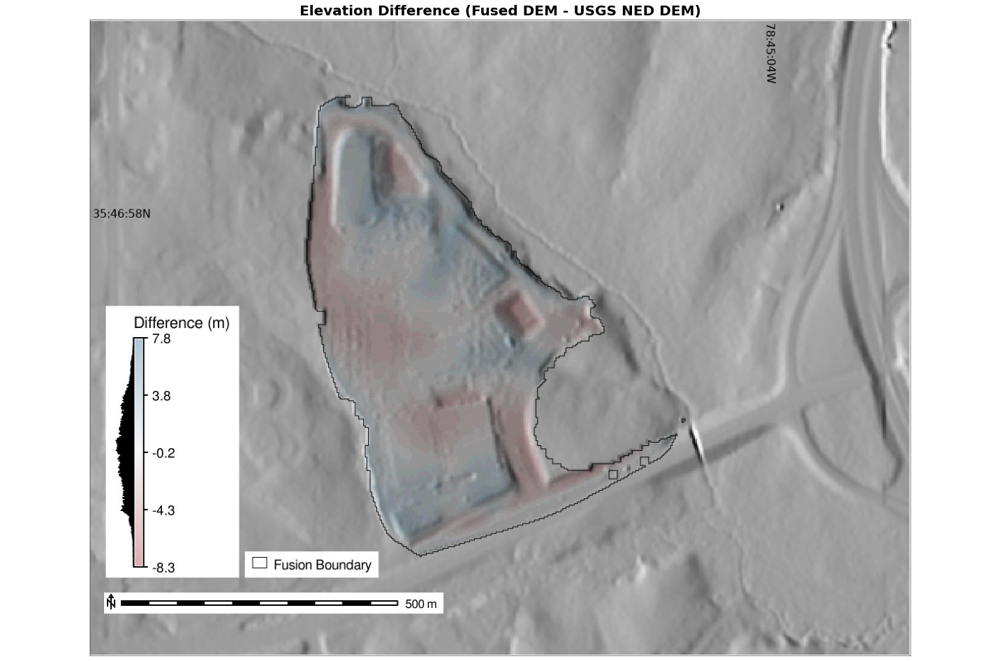

In [131]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 1,1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img1 = Image.open("output/fenton_bare_earth_fused_diff.png")
imgplot = plt.imshow(img1)
ax.set_title('Elevation Difference (Fused DEM - USGS NED DEM)',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/fusion_diff_figures.png",bbox_inches='tight',dpi=300)

### Extract Stormwater Inlets and Gravity Mains from Town of Cary

In [136]:
!g.copy vector=site_1_inlets_dem@rapid-dsm,site_1_inlets_dem
# !g.copy vector=Cary_Stormwater_Network_Inlets@rapid-dsm,Cary_Stormwater_Network_Inlets
# !g.copy vector=Cary_Stormwater_Network_Gravity_Mains@rapid-dsm,Cary_Stormwater_Network_Gravity_Mains
# !g.copy raster=ned_19sec_site_priority_1@rapid-dsm,ned_19sec_site_priority_1

# !g.copy region=site_1@rapid-dsm,site_1

Copying vector <site_1_inlets_dem@rapid-dsm> to current mapset as
<site_1_inlets_dem>
         overwritten
WARNING: Unable to open header file of vector <site_1_inlets_dem@rapid-dem>
ERROR: Unable to read header file of vector map
       <site_1_inlets_dem@rapid-dem>


In [133]:
gs.run_command("r.to.vect", input="bare_earth_mask", output="bare_earth_mask_thin", type="area", overwrite=True)

# https://data.wakegov.com/datasets/carync::storm-inlets/about
# https://opendata.arcgis.com/datasets/0bd48809ae264e848532188b893df894_35.geojson
!v.select -c --overwrite ainput=Cary_Stormwater_Network_Inlets binput=bare_earth_mask_thin output=site_1_inlets operator=within

# https://data.wakegov.com/datasets/carync::storm-gravity-mains/about
# https://opendata.arcgis.com/datasets/0bd48809ae264e848532188b893df894_31.geojson
!v.select -c --overwrite ainput=Cary_Stormwater_Network_Gravity_Mains binput=bare_earth_mask_thin output=site_1_gravity_mains operator=within

         <Cary_Stormwater_Network_Inlets@rapid-dem>
ERROR: Unable to read header file of vector map
       <Cary_Stormwater_Network_Inlets@rapid-dem>
WARNING: Unable to open header file of vector
         <Cary_Stormwater_Network_Gravity_Mains@rapid-dem>
ERROR: Unable to read header file of vector map
       <Cary_Stormwater_Network_Gravity_Mains@rapid-dem>


In [135]:
import pandas as pd
import sqlite3
 
# Read in the attribute table
sqlpath = gs.read_command("db.databases", driver="sqlite").replace('\n', '')
con = sqlite3.connect(sqlpath)
sqlstat="SELECT * FROM site_1_inlets_dem"
df_inlets = pd.read_sql_query(sqlstat, con)
con.close()
df_profile = df_inlets[['cat','FACILITYID','RIMELEV', 'INLETTYPE']][df_inlets.RIMELEV> 0]
df_profile.head()

DatabaseError: Execution failed on sql 'SELECT * FROM site_1_inlets_dem': no such table: site_1_inlets_dem

In [4809]:
# !r.what -n -v map=bare_earth_thin,fenton_bare_earth_fused,ned_19sec_site_priority_1 points=site_1_inlets
gs.parse_command("r.what", map="bare_earth_thin,fenton_bare_earth_fused,ned_19sec_site_priority_1", points="site_1_inlets", flags="nv", output="output/inlet_elevations.csv")
df_inlet_dem_elevs = pd.read_csv("output/inlet_elevations.csv",sep="|")
df_inlet_dem_elevs = df_inlet_dem_elevs.drop(['site_name'], axis=1)
df_inlet_dem_elevs.head(10)

,cat,easting,northing,bare_earth_thin,fenton_bare_earth_fused,ned_19sec_site_priority_1
0,3617,631623.47076,224987.204574,133.095230,133.095230,133.5082
1,3618,631748.74386,225045.603274,133.636707,134.100639,137.9426
2,3619,631960.66406,225122.242074,134.045873,134.806423,135.0465
3,4220,631617.06996,225000.724474,135.841048,135.841048,133.7924
4,30778,631762.51316,225027.431374,133.863539,133.863539,134.0154
5,30779,631694.29116,225064.871974,133.289918,133.659982,139.0885
6,30780,631702.84086,225048.581974,133.065975,133.065975,138.3381
7,30781,631690.23736,225038.681774,133.398722,133.398722,137.6727
8,30782,631673.86196,225025.991674,133.622863,133.622863,136.8225
9,30783,631668.64226,225008.351474,133.185445,133.185445,134.9834


In [4810]:
df_inlet_elves = df_profile.set_index('cat').join(df_inlet_dem_elevs.set_index('cat'),on="cat",lsuffix="_inlets", rsuffix="_dem", how="outer")
df_inlet_elves = df_inlet_elves.dropna(axis='rows')

def perc_err(t, e):
    err = abs(round((( e - t ) / t) * 100,2))
    return err


# df_inlet_elves.info()
df_inlet_elves['inlet_rim_m'] = df_inlet_elves.apply(lambda x: x['RIMELEV'] / 3.2808, axis=1)
df_inlet_elves['USGS NED DEM % Error'] = df_inlet_elves.apply(lambda x: perc_err(x['inlet_rim_m'],x['ned_19sec_site_priority_1']), axis=1)
df_inlet_elves['Fused UAS DEM % Error'] = df_inlet_elves.apply(lambda x: perc_err(x['inlet_rim_m'],x['fenton_bare_earth_fused']), axis=1)
df_inlet_elves['UAS DEM % Error'] = df_inlet_elves.apply(lambda x: perc_err(x['inlet_rim_m'],x['bare_earth_thin']), axis=1)

df_inlet_elves['USGS NED Diff'] = df_inlet_elves.apply(lambda x: x['inlet_rim_m'] - x['ned_19sec_site_priority_1'], axis=1)
df_inlet_elves['Fused UAS Diff'] = df_inlet_elves.apply(lambda x: x['inlet_rim_m'] - x['fenton_bare_earth_fused'], axis=1)
df_inlet_elves['UAS DEM Diff'] = df_inlet_elves.apply(lambda x: x['inlet_rim_m'] - x['bare_earth_thin'] , axis=1)

df_inlet_latex = df_inlet_elves.drop(['cat','INLETTYPE','RIMELEV','easting','northing'],axis=1).rename(columns={
    # "easting":"x",
    # "northing": "y",
    "inlet_rim_m": "Inlet Rim Elev",
    "bare_earth_thin": "UAS DEM",
    "fenton_bare_earth_fused": "Fused UAS DEM",
    "ned_19sec_site_priority_1": "USGS NED DEM"
}, errors="raise")
df_inlet_latex = df_inlet_latex[['FACILITYID','Inlet Rim Elev','USGS NED DEM','USGS NED Diff',"UAS DEM",'UAS DEM Diff',"Fused UAS DEM",'Fused UAS Diff']].round(2)

caption = "The inlets ..."

print(df_inlet_latex.to_latex(index=False,bold_rows=True, caption=caption))

\begin{table}
\centering
\caption{The inlets ...}
\begin{tabular}{lrrrrrrr}
\toprule
FACILITYID &  Inlet Rim Elev &  USGS NED DEM &  USGS NED Diff &  UAS DEM &  UAS DEM Diff &  Fused UAS DEM &  Fused UAS Diff \\
\midrule
DP77305061 &          132.66 &        133.51 &          -0.85 &   133.10 &         -0.44 &         133.10 &           -0.44 \\
DP77306010 &          133.38 &        137.94 &          -4.56 &   133.64 &         -0.25 &         134.10 &           -0.72 \\
DP77306002 &          135.45 &        135.05 &           0.41 &   134.05 &          1.41 &         134.81 &            0.65 \\
DP77306019 &          134.50 &        134.02 &           0.49 &   133.86 &          0.64 &         133.86 &            0.64 \\
DP77305094 &          133.87 &        139.09 &          -5.22 &   133.29 &          0.58 &         133.66 &            0.21 \\
DP77306020 &          133.61 &        138.34 &          -4.73 &   133.07 &          0.54 &         133.07 &            0.54 \\
DP77305095 &     

In [4811]:
df_inlet_elves[['USGS NED DEM % Error','Fused UAS DEM % Error','UAS DEM % Error']].describe()


,USGS NED DEM % Error,Fused UAS DEM % Error,UAS DEM % Error
count,9.000000,9.000000,9.000000
mean,2.116667,0.316667,0.371111
std,1.440642,0.174929,0.289717
min,0.300000,0.030000,0.030000
25%,0.640000,0.170000,0.190000
50%,2.430000,0.330000,0.330000
75%,3.420000,0.480000,0.440000
max,3.900000,0.540000,1.040000


#### RMSE

In [4812]:
def rmse(predictions, targets):
    # print((df_inlet_latex[predictions] - df_inlet_latex[targets]) ** 2)
    return np.sqrt(((df_inlet_latex[predictions] - df_inlet_latex[targets]) ** 2).mean())

usgs_dem_rmse = rmse('USGS NED DEM', 'Inlet Rim Elev')
print(f"USGS DEM RMSE: {usgs_dem_rmse}")
uas_dem_rmse = rmse('UAS DEM', 'Inlet Rim Elev')
print(f"UAS DEM RMSE: {uas_dem_rmse}")
fused_dem_rmse = rmse('Fused UAS DEM', 'Inlet Rim Elev')
print(f"Fused UAS DEM RMSE: {fused_dem_rmse}")

# from sklearn.metrics import mean_squared_error
# from math import sqrt

# rms = sqrt(mean_squared_error(y_actual, y_predicted))
# df_inlet_elves['USGS NED DEM RMSE'] = df_inlet_elves.apply(lambda x: rmse(x['inlet_rim_m'],x['ned_19sec_site_priority_1'], x.count()), axis=1)


USGS DEM RMSE: 3.359078908140006
UAS DEM RMSE: 0.6172429739485763
Fused UAS DEM RMSE: 0.4757450297515798


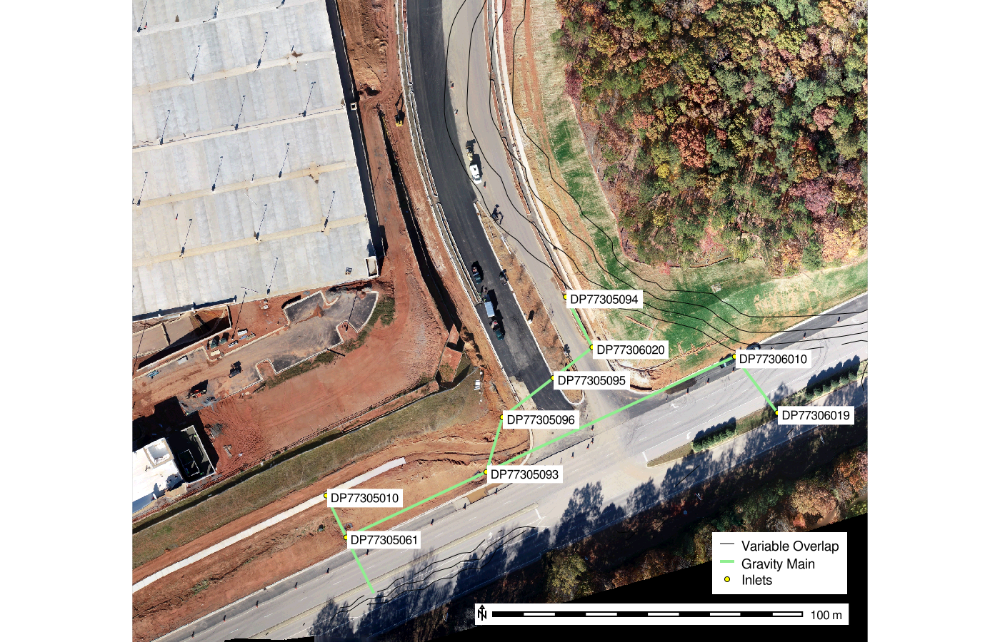

In [3376]:
gs.run_command("g.region",region="region_site_1_inlets", res=0.05, flags="pa")

fenton_bare_earth_edge_diff_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_inlets_map.png")
fenton_bare_earth_edge_diff_map.d_erase()
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_relief")

# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_diff_shaded_relief")

# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_ned_edge_diff1")
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_odm_ortho_composite_5cm")


fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")
fenton_bare_earth_edge_diff_map.d_vect(map="site_1_gravity_mains",fill_color="none",type="line", color="144:238:144:255", width="4", legend_label="Gravity Main")
fenton_bare_earth_edge_diff_map.d_vect(map="site_1_inlets",
                                       fill_color="yellow",
                                       icon="basic/point",
                                       size=14, color="black",
                                       type="point",
                                       legend_label="Inlets",
                                       attribute_column="FACILITYID",label_size=12, label_color="0:0:0:255", label_bgcolor="white", font="FreeSans"
                                      )


fenton_bare_earth_edge_diff_map.d_legend_vect(at=(72,17),font="FreeSans", flags="b",border_color="none")

# fenton_bare_earth_edge_diff_map.d_legend(raster="fenton_bare_earth_ned_edge_diff1",
#                                              at=(14,50,13,14),
#                                              title="Difference (m)", title_fontsize=16, border_color="none",
#                                              fontsize=14, font="FreeSans",
#                                              flags="btd")
fenton_bare_earth_edge_diff_map.d_barscale(at=(47.5,6), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_edge_diff_map.show()

### Profiles

#### Profile 1

631433.0352338348,224953.364507352,631714.7764115902,225078.8733382778
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
number of features with non NULL attribute: 102
number of missing attributes: 0
number of NULL attributes: 0
minimum: -1.36669
maximum: 2.95849
range: 4.32518
sum: 81.4211
mean: 0.798246
mean of absolute values: 1.44039
population standard deviation: 1.37514
population variance: 1.89101
population coefficient of variation: 1.7227
sample standard deviation: 1.38193
sample variance: 1.90973
kurtosis: -1.40899
skewness: -0.290488
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
number of features with non NULL attribute: 102
number of missing attributes: 0
number of NULL attributes: 0
minimum: -1.36669
maximum: 2.95849
range: 4.32518
sum: 81.4211
mean: 0.798246
mean of absolute values: 1.44039
popu

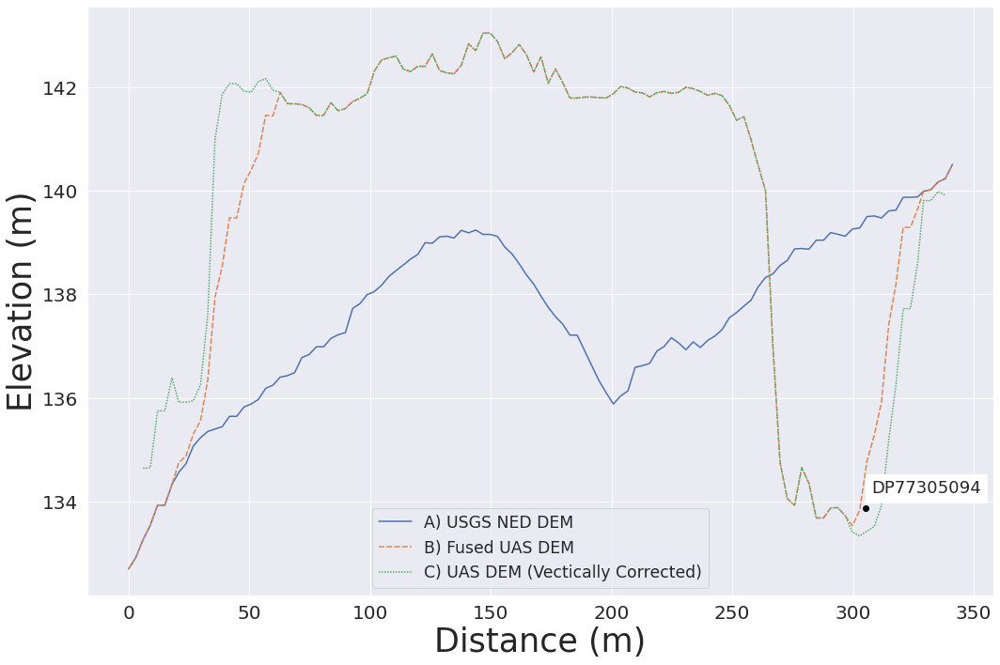

In [5096]:
#https://ncsu-geoforall-lab.github.io/uav-lidar-analytics-course/assignments/fusion_uas_lidar.html
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")

def profile_dem(dem, output, coords):
    out = f"output/{output}.csv"
    gs.run_command("r.profile", flags="gc", input=dem, coordinates=coords, output=out,null_value="0", overwrite=True)
    gs.run_command("v.in.ascii", input=out, output=output, separator="space", columns="x double,y double,profile double,diff double, color varchar", overwrite=True)
    # gs.run_command("v.in.ascii", input=out,format="line", output=f"{output}_line", separator="space", columns="x double,y double,profile double,diff double, color varchar", overwrite=True)

    # gs.run_command("v.to.lines", input=output, output=f"{output}_line", overwrite=True)
    !v.univar map=profile_fenton_shift column=diff
    df = pd.read_csv(out,delimiter=" ", names=['x','y','profile','diff','color'])
    return df

# original
pcoords = "631762.560090676,225027.32533114706,631748.6951814141,225045.6585523984,631702.8559240397,225048.70779850797,631694.5815714869,225064.8967491548,631659.1685947867,225157.70719988446,631686.3436535287,225251.37442363356,631744.7411201871,225321.3357450758" #,631696.7511228342,225387.82791008288,631549.3119743402,225545.67452788228,631484.5543875508,225641.65452258813" #,631445.2372812857,225685.01897802754,631401.2946331071,225705.83391663845,631371.2286106691,225714.5068077263,631333.6460826216,225715.6631932047"
# New
pcoords = "631433.0352338348,224953.364507352,631714.7764115902,225078.8733382778"
pcoords_fused = "631414.1714507325, 224944.61835873662,631433.0352338348,224953.364507352,631714.7764115902,225078.8733382778,631727.3167138431, 225085.0137442272"
print(pcoords)
df_ned = profile_dem("ned_19sec_site_priority_1","ned_19sec_fenton_profile",pcoords_fused)
# df_uas = profile_dem("bare_earth_smooth","bare_earth_profile",pcoords)
df_uas = profile_dem("bare_earth","bare_earth_profile",pcoords_fused)
df_fused = profile_dem("fenton_bare_earth_fused","fenton_bare_earth_fused_profile",pcoords_fused)
df_ned['DEMs'] = "A) USGS NED DEM"
df_fused['DEMs'] = "B) Fused UAS DEM"
df_uas['DEMs'] = "C) UAS DEM (Vectically Corrected)"
df_uas = df_uas[df_uas['diff'] > 0]
df_profiles = pd.concat([df_ned, df_fused, df_uas], ignore_index=True)
df_profiles.head(10)

# df_inlet_elves_profiles.reset_index(inplace=True)
sns.set_theme(style="darkgrid")
fig = plt.figure(figsize=(15, 10))
ax = sns.lineplot(x="profile", y="diff", hue="DEMs", data=df_profiles, style="DEMs");

# ax.set_title('Elevation Profiles',{"fontsize":20, "fontweight":"bold"})
ax.set_xlabel('Distance (m)', fontsize=35)
ax.set_ylabel('Elevation (m)', fontsize=35)
ax.tick_params(labelsize=20)
ax.legend(loc='upper right', fontsize=40)
plt.setp(ax.get_legend().get_texts(), fontsize='50') # for legend text
plt.legend(fontsize='x-large', title_fontsize='50')

# plt.axhline(df_ned["diff"].mean(), color='blue', linestyle='dashed',label="USGS NED DEM (Mean)")
# plt.axhline(df_fused["diff"].mean(), color='orange', linestyle='dashed',label="Fused DEM (Mean)") #max
# plt.axhline(df_uas["diff"].mean(), color='green', linestyle='dashed',label="UAS DEM (Vectically Corrected) (Mean)") #min
# sns.scatterplot(data=df_inlet_elves_profiles, x="diff", y="Inlet Rim Elev", hue="DEMs", size="Fused UAS DEM % Error", ax=ax)
print(f'USGS NED DEM Mean: {df_ned["diff"].mean()}')

# plt.axhline(df_priority["value"].median(), color='black', ls="--")
# plt.axhline(df_conf_envelope["value_thres"].max(), color='grey', ls=":") #max
# plt.axhline(df_conf_envelope["value_thres"].min(), color='grey', ls=":") #min
# handles, labels = ax.get_legend_handles_labels()
# print(handles, labels)

print(df_uas['profile'].loc[0:0])
inlet_point = [df_uas['profile'].loc[0:0],df_uas['diff'].loc[0:0]]
# plt.text(0 + 2.5,134.503780 + 0.25,'DP77306019',backgroundcolor="white",va="bottom",ha="center",fontsize=10)
# plt.plot(0, 134.503780, marker="o", markersize=6, markeredgecolor="black", markerfacecolor="black")
# plt.text(68.55 + 2.5,133.610705 + 0.55,'DP77306020',backgroundcolor="white",va="top",ha="left",fontsize=10)
# plt.plot(68.55, 133.610705, marker="o", markersize=6, markeredgecolor="black", markerfacecolor="black")
plt.text(305.2 + 2.5,133.87 + 0.55,'DP77305094',backgroundcolor="white",va="top",ha="left",fontsize=18)
plt.plot(305.2, 133.87, marker="o", markersize=6, markeredgecolor="black", markerfacecolor="black")


# plt.legend(handles=[plt],labels=['Median', 'Envelope'])

plt.tight_layout()
plt.savefig("output/elvation_profiles.png",bbox_inches='tight',dpi=300)
sns.set_theme(style="white", palette=None)

#### Profile 2

631372.0386530948,225150.9634490288,631724.4271637119,225414.11071345065
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
number of features with non NULL attribute: 102
number of missing attributes: 0
number of NULL attributes: 0
minimum: -1.36669
maximum: 2.95849
range: 4.32518
sum: 81.4211
mean: 0.798246
mean of absolute values: 1.44039
population standard deviation: 1.37514
population variance: 1.89101
population coefficient of variation: 1.7227
sample standard deviation: 1.38193
sample variance: 1.90973
kurtosis: -1.40899
skewness: -0.290488
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
number of features with non NULL attribute: 102
number of missing attributes: 0
number of NULL attributes: 0
minimum: -1.36669
maximum: 2.95849
range: 4.32518
sum: 81.4211
mean: 0.798246
mean of absolute values: 1.44039
po

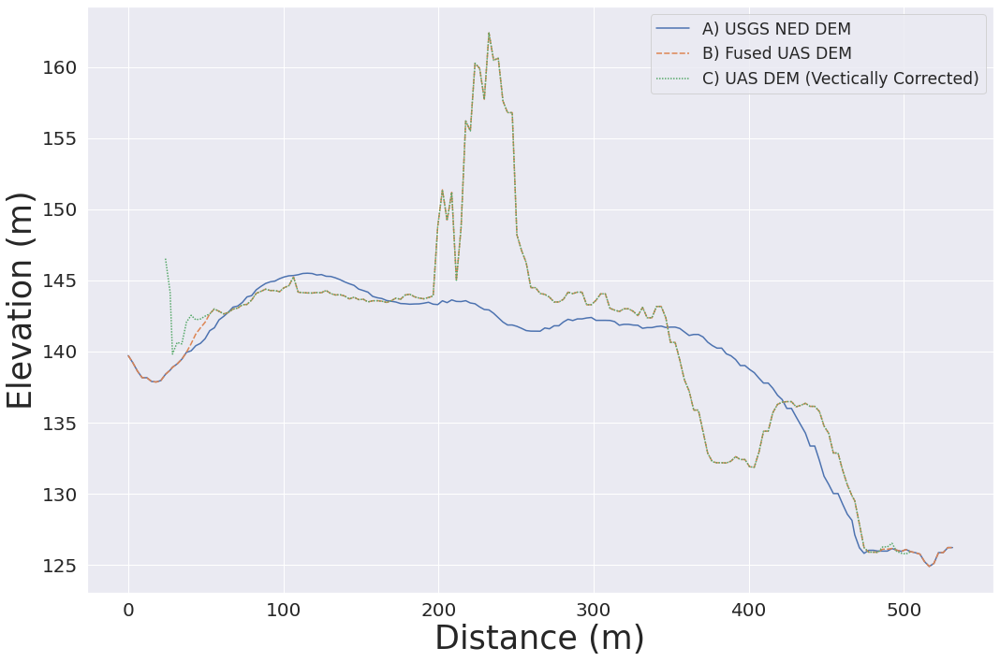

In [5065]:
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")

pcoords = "631358.3092306032,225189.8634794216,631711.8418597612,225424.4077803193"
pcoords = "631372.0386530948,225150.9634490288,631724.4271637119,225414.11071345065"
pcoords_fused = "631349.512049384, 225133.45258284573,631372.0386530948,225150.9634490288,631724.4271637119,225414.11071345065,631772.4050179613, 225458.1747846255"

print(pcoords)
df_ned = profile_dem("ned_19sec_site_priority_1","ned_19sec_fenton_profile2",pcoords_fused)
# df_uas = profile_dem("bare_earth_smooth","bare_earth_profile",pcoords)
df_uas = profile_dem("bare_earth","ned_19sec_fenton_profile2",pcoords_fused)
df_fused = profile_dem("fenton_bare_earth_fused","ned_19sec_fenton_profile2",pcoords_fused)
df_ned['DEMs'] = "A) USGS NED DEM"
df_fused['DEMs'] = "B) Fused UAS DEM"
df_uas['DEMs'] = "C) UAS DEM (Vectically Corrected)"
df_uas = df_uas[df_uas['diff'] > 0]

df_profiles = pd.concat([df_ned, df_fused, df_uas], ignore_index=True)
df_profiles.head(10)

# df_inlet_elves_profiles.reset_index(inplace=True)
sns.set_theme(style="darkgrid")
fig = plt.figure(figsize=(15, 10))
ax = sns.lineplot(x="profile", y="diff", hue="DEMs", data=df_profiles, style="DEMs");
# plt.legend(fontsize='x-large', title_fontsize='40')

ax.set_xlabel('Distance (m)', fontsize=35)
ax.set_ylabel('Elevation (m)', fontsize=35)
ax.tick_params(labelsize=20)
ax.legend(loc='upper right', fontsize=40)
plt.setp(ax.get_legend().get_texts(), fontsize='50') # for legend text
plt.legend(fontsize='x-large', title_fontsize='50')
# plt.axhline(df_ned["diff"].mean(), color='blue', linestyle='dashed',label="USGS NED DEM (Mean)")
# plt.axhline(df_fused["diff"].mean(), color='orange', linestyle='dashed',label="Fused DEM (Mean)") #max
# plt.axhline(df_uas["diff"].mean(), color='green', linestyle='dashed',label="UAS DEM (Vectically Corrected) (Mean)") #min
# sns.scatterplot(data=df_inlet_elves_profiles, x="diff", y="Inlet Rim Elev", hue="DEMs", size="Fused UAS DEM % Error", ax=ax)
print(f'USGS NED DEM Mean: {df_ned["diff"].mean()}')


# ax.legend(loc='upper right',fontsize=30)

# plt.legend(handles=[plt],labels=['Median', 'Envelope'])
# plt.legend()
plt.tight_layout()
plt.savefig("output/elvation_profiles2.png",bbox_inches='tight',dpi=300)
sns.set_theme(style="white", palette=None)

In [4968]:
gs.run_command("r.mask", raster="fenton_odm_dtm_5cm", overwrite=True)


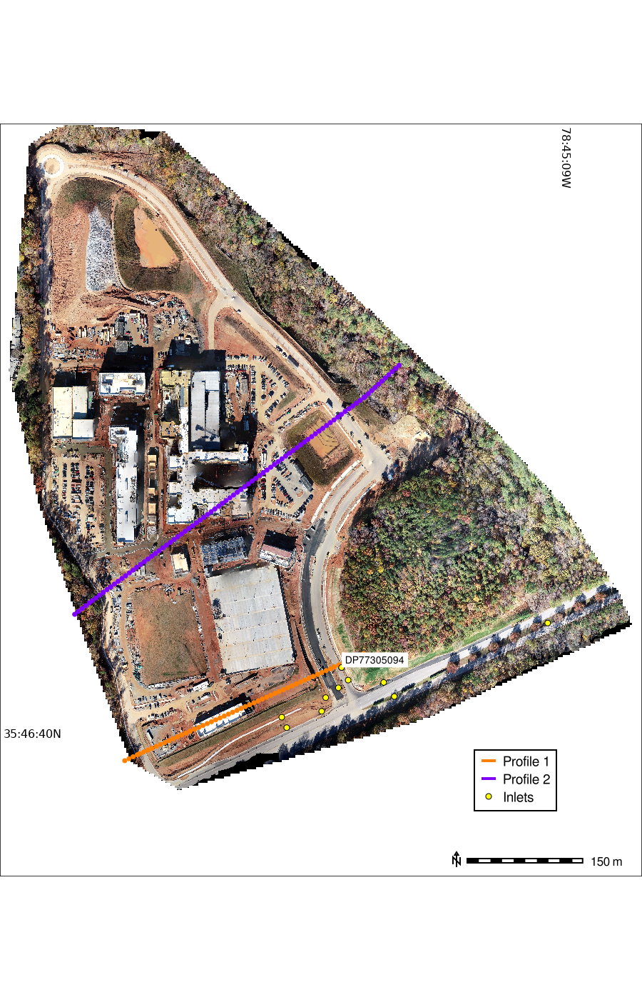

In [5004]:
# gs.run_command("g.region",region="region_site_1_inlets", res=0.05, flags="pa")
# gs.run_command("g.region",region="site_1", res=0.05, flags="pa")
# gs.run_command("g.region",raster="profile_view", res=3, flags="pa")

# gs.run_command("g.region",raster="fenton_odm_dtm_5cm", res=3, flags="pa")
# gs.run_command("r.contour",overwrite=True, input="fenton_bare_earth_fused", output="fenton_bare_earth_fused_contours",step=2)
gs.run_command("g.region",raster="fenton_odm_dtm_5cm", res=0.05, flags="pa")

# gs.run_command("g.region",region="profile_view", res=0.05, flags="pa")
gs.run_command("r.mask", raster="cary_town_blvd_flight_1_odm_dtm_3m")
view_reg = gs.region("fenton_odm_dtm_5cm")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 175
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 100



gs.run_command("g.region",
               raster="fenton_odm_dtm_5cm",
               # n=view_reg_n,
               # w=view_reg_w,
               # e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=0.05, flags="pa")
fenton_bare_earth_edge_diff_map = gj.GrassRenderer(height=1400, width=900,filename="output/fenton_proife_map.png")
fenton_bare_earth_edge_diff_map.d_erase()
# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_relief")

# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_fused_diff_shaded_relief")
# Trick the legend to show the profile as a line using another feature
fenton_bare_earth_edge_diff_map.d_vect(map="site_1_gravity_mains",fill_color="none",type="line", color="orange", width="4", legend_label="Profile 1")
fenton_bare_earth_edge_diff_map.d_vect(map="site_1_gravity_mains",fill_color="none",type="line", color="purple", width="4", legend_label="Profile 2")
fenton_bare_earth_edge_diff_map.d_rast(map="fenton_odm_ortho_composite_5cm")

fenton_bare_earth_edge_diff_map.d_vect(map="site_1_inlets",
                                       fill_color="yellow",
                                       icon="basic/point",
                                       size=16, color="black",
                                       type="point",
                                       legend_label="Inlets",
                                       # attribute_column="FACILITYID",label_size=10, label_color="0:0:0:255", label_bgcolor="white", font="FreeSans",
                                       # where="FACILITYID = 'DP77305094'", #OR FACILITYID = 'DP77306010'
                                       # xref="left",
                                       # yref="bottom",
                                       flags="s"
                                      )




# fenton_bare_earth_edge_diff_map.d_rast(map="fenton_bare_earth_ned_edge_diff1")


# fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_contours",fill_color="none",type="line", color="191:191:191", width="2", legend_label="Elev Contours (2m)")

# fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")
# fenton_bare_earth_edge_diff_map.d_vect(map="site_1_gravity_mains",fill_color="none",type="line", color="144:238:144:255", width="4", legend_label="Gravity Main")
fenton_bare_earth_edge_diff_map.d_vect(map="fenton_bare_earth_fused_profile",
                                       # rgb_column="color",
                                       color="orange",
                                       fill_color="orange",
                                       size="12", 
                                       legend_label="Profile 1",
                                       where="profile % 2 = 0",
                                       icon="basic/point",
                                       flags="s")

fenton_bare_earth_edge_diff_map.d_vect(map="ned_19sec_fenton_profile2",
                                       # rgb_column="color",
                                       color="purple",
                                       fill_color="purple",
                                       size="12", 
                                       legend_label="Profile 2",
                                       where="profile % 2 = 0",
                                       icon="basic/point",
                                       flags="s")


fenton_bare_earth_edge_diff_map.d_vect(map="site_1_inlets",
                                       fill_color="yellow",
                                       icon="basic/point",
                                       size=16, color="black",
                                       type="point",
                                       # legend_label="Inlets",
                                       attribute_column="FACILITYID",label_size=10, label_color="0:0:0:255", label_bgcolor="white", font="FreeSans",
                                       where="FACILITYID = 'DP77305094'", #OR FACILITYID = 'DP77306010'
                                       xref="left",
                                       yref="bottom",
                                       legend_label="Inlets"
                                      )





fenton_bare_earth_edge_diff_map.d_legend_vect(at=(75,25),font="FreeSans", flags="b",border_color="black")

# fenton_bare_earth_edge_diff_map.d_legend(raster="bare_earth_profile",
#                                              at=(14,50,13,14),
#                                              title="Difference (m)", title_fontsize=16, border_color="none",
#                                              fontsize=14, font="FreeSans",
#                                              flags="btd")
fenton_bare_earth_edge_diff_map.d_barscale(at=(70,15), units="meters",font="FreeSans", flags="n",length="150")
fenton_bare_earth_edge_diff_map.d_grid(size="00:00:50", flags="dw", width=1, color="black",text_color="black",fontsize=16)
fenton_bare_earth_edge_diff_map.d_grid(size="00:00:51", flags="dw", width=1, color="black",text_color="black",fontsize=16)

gs.run_command("r.mask", flags="r")
fenton_bare_earth_edge_diff_map.show()


w: 823, h: 487


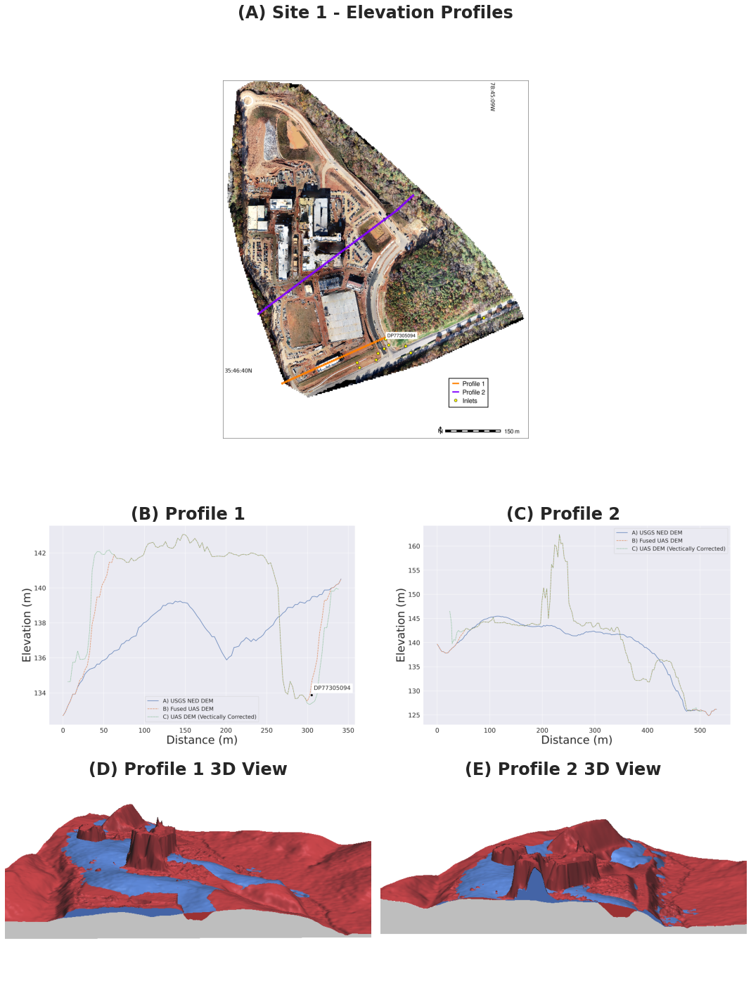

In [5097]:
from PIL import Image

fig = plt.figure(figsize=(15, 20),constrained_layout=False)
sns.set_theme(style="white", palette=None)
grs = fig.add_gridspec(8, 2)

ax = fig.add_subplot(grs[0:4, :])
# fig.subplots_adjust(hspace=0.5, wspace=0.5)
ax.set_axis_off()
img_ortho = Image.open("output/fenton_proife_map.png")
imgplot = plt.imshow(img_ortho)
ax.set_title('(A) Site 1 - Elevation Profiles',{"fontsize":24, "fontweight":"bold"})
# ax.axis('off')
# plt.colorbar(ticks=[0.1, 0.3, 0.5, 0.7], orientation='horizontal')
ax = fig.add_subplot(grs[4:6, 0])
ax.set_title('(B) Profile 1',{"fontsize":24, "fontweight":"bold"})
img2 = Image.open("output/elvation_profiles.png")
imgplot = plt.imshow(img2)
ax.axis('off')

# imgplot.set_clim(0.0, 0.7)
ax = fig.add_subplot(grs[4:6, 1])
ax.set_title('(C) Profile 2',{"fontsize":24, "fontweight":"bold"})
img2 = Image.open("output/elvation_profiles2.png")
imgplot = plt.imshow(img2)
ax.axis('off')


ax = fig.add_subplot(grs[6:8,0])
ax.set_title('(D) Profile 1 3D View',{"fontsize":24, "fontweight":"bold"})
img2 = Image.open("output/profile13d.png")
imgplot = plt.imshow(img2)
ax.axis('off')


ax = fig.add_subplot(grs[6:8, 1])
ax.set_title('(E) Profile 2 3D View',{"fontsize":24, "fontweight":"bold"})
img2 = Image.open("output/profile23d.png")
img2width, img2height = img2.size
print(f"w: {img2width}, h: {img2height}")
# Setting the points for cropped image
img2left = 0 #img2width
img2top = 0 -200 # img2height
img2right = img2width# img2width
img2bottom = img2height #300 * img2height / 4

 
# Cropped image of above dimension
# (It will not change original image)
# img2 = img2.crop((img2left, img2top, img2right, img2bottom))
imgplot = plt.imshow(img2)
ax.axis('off')


plt.tight_layout()
plt.savefig("output/elvation_profiles_figures.png",dpi=300)

Check for Shift

# Surface Water Flow

In [3584]:
def simwe(elev, nlcd, output):
    dx = f'dx_{output}'
    dy = f'dy_{output}'
    mannings = f'mancover_{output}'
    raincover = f'raincover_{output}'
    runoff_coef = f'runoff_coef_{output}'
    freq_factor = 1.25
    rain_intensity = 79.248
    depth = f'depth_variable_rainfall_{output}'
    print(f"Depth: {depth}")
    
    discharge = f'discharge_variable_rainfall_{output}'
    print(f"Discharge: {discharge}")
    # compute dx, dy
    gs.run_command("r.slope.aspect", elevation=elev, dx=dx, dy=dy, overwrite=True)

    # # Calculate manning coefficient
    gs.run_command("r.recode", input=nlcd, output=mannings, rules="grass_config/classified_to_mannings.txt")

    # # Calculate variable rainfall using nlcd
    gs.run_command("r.recode", input=nlcd, output=runoff_coef, rules="grass_config/classified_runoff_coefficent.txt")
    rain_fall_excess_calc = f"({runoff_coef} * {freq_factor} * {rain_intensity})"
    gs.run_command("r.mapcalc", 
        expression=f"{raincover} = if({rain_fall_excess_calc} > {rain_intensity}, {rain_intensity}, {rain_fall_excess_calc})",
        overwrite=True)

    # NOAA ATLAS 14 POINT PRECIPITATION FREQUENCY ESTIMATES
    # Get 100 year flood event critiera (Percipiation frequency)
    # https://hdsc.nws.noaa.gov/hdsc/pfds/pfds_map_cont.html?bkmrk=nc

    # Duration | 100 yr 
    # 30 min     2.33 in
    # 60 min     3.21 in (79.248mm)

    # Calculate SCS Curve Number (CN)
    # https://serc.carleton.edu/hydromodules/steps/creating_excess.html
    # initial abstraction (la) = 0.2S # 20% of the total maximum storage or retention of watershed
    # continous abstraction (Fa) = S * (P-la)\(P-la + S)
        # Total Retention (S) = 0
        # Total Rainfall (P) = 79.248mm

    #Rational Method
    # C
    # Cf = 1.25

    gs.run_command("r.sim.water", 
        elevation=elev, 
        dx=dx,
        dy=dy,
        # rain_value=79.248,
        rain=raincover,
        infil_value=0,
        man=mannings,
        depth=depth,
        disch=discharge,
        nwalk=1000000,
        nprocs=14,
        output_step=60, # Time step in minutes
        niterations=60 # Total time of event in minutes
    )

    # Extract flooded pixels with a depth >= 0.025m (~1in)
    filtered_depth = f"pf_100yr_{output}"
    print(f"Filtered Depth: {filtered_depth}")
    expression = f"{filtered_depth} = if({depth} >= 0.025,  {depth}, null())"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=filtered_depth, raster=depth)

    return filtered_depth


def simweSimple(elev, output):
    dx = f'dx_{output}'
    dy = f'dy_{output}'
    error = f'simwe_error_{output}'
    walkers = f'walkers_{output}'
    print(f"Walkers: {walkers}")

    depth = f'depth_{output}'
    print(f"Depth: {depth}")
    
    discharge = f'discharge_{output}'
    print(f"Discharge: {discharge}")
    # compute dx, dy
    gs.run_command("r.slope.aspect", elevation=elev, dx=dx, dy=dy, overwrite=True)
    # r.sim.water -t rain_value=30 man_value=0.15 depth=ground_depth discharge=ground_disch nwalkers=100000 niterations=20 output_step=1 hmax=0.2 halpha=8.0 hbeta=1.0

    gs.run_command("r.sim.water", 
        elevation=elev, 
        dx=dx,
        dy=dy,
        depth=depth,
        disch=discharge,
        rain_value=100,
        infil_value=0,
        man_value=0.1,
        output_step=60, # Time step in minutes
        niterations=60, # Total time of event in minutes
                   
        # rain_value=30, #Rainfall excess rate unique value [mm/hr]
        # infil_value=0, # Runoff infiltration rate unique value [mm/hr]
        # man_value=0.15, # Manning's n unique value
        # output_step=1, # Time step in minutes
        # niterations=30, # Total time of event in minutes
        # hmax=0.2,   # Threshold water depth [m]. Diffusion increases after this water depth is reached
        # halpha=8.0, #Diffusion increase constant
        # hbeta=1.0, #Weighting factor for water flow velocity vector
                   
        flags="", #t
        # error=error,
        # walkers_output=walkers,
        nwalk=100000, # Set Back to 1m
        nprocs=14,
        random_seed="1"
    )

def analyze_hydrology(dem, uas, fused, drainage, stream, basin, accumulation, threshold, memory=10000, overwrite=False):
    print("*" * 50)
    
    if uas:
        print(f"Starting Fusion...")
        fusion(dem = dem,uas=uas, output=fused, usgs=False)
        print(f"Fused: {fused}")
    else:
        # Set fused variable to dem if no fusion is performed
        fused = dem
        
        
    # Need to reset the region to the whole study area
    gs.run_command("g.region",raster=dem, res=3, flags="pa")
    print(f"Creating Watersheds...")
    gs.run_command("r.watershed", elevation=fused, 
                   threshold=threshold,
                   drainage=drainage, 
                   stream=stream, 
                   basin=basin,
                   accumulation=accumulation,
                   memory=memory, overwrite=overwrite)
    
    print(f"Extracting Streams...")
    gs.run_command("r.stream.extract",
        elevation=fused,
        threshold=threshold, 
        mexp=0, 
        memory=memory, 
        stream_raster=f"{stream}_ext", 
        stream_vector=f"{stream}_ext",
        overwrite=overwrite
      )
    print(f"Converting Basins to Vectors...")
    gs.run_command("r.to.vect", input=basin, output=basin, type="area", overwrite=overwrite)
    
    print(f"Running SIMWE...")
    simweSimple(fused, fused)
    print("*" * 50)
    
    
def generate_depth_map(depth, flooding, filename, relief, depth_filter=0.075):
    """
    @param depth_filter : float : 0.075m is ~0.25ft
    """
    print(f"Flooding Depth: {flooding}")
    expression = f"{flooding} = if({depth} >= {depth_filter},  {depth}, null())"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=flooding, raster=depth)
    output = f"output/{flooding}.png"
    print(f"Image Save Location: {output}")

    flooding_map = gj.GrassRenderer(height=900,width=1400,filename=output)
    flooding_map.d_erase()
    flooding_map.d_rast(map=relief)
    flooding_map.d_rast(map=flooding)
    flooding_map.d_legend(raster=flooding, at=(10,50,2,6), title="Depth (m)",flags="l")
    flooding_map.d_barscale(at=(1,6,2,2), units="meters", flags="n")
    return flooding_map.show()

def generate_discharge_map(disch, flooding, filename, relief, disch_filter=0.075):
    """
    @param depth_filter : float : 0.075m is ~0.25ft
    """
    print(f"Flooding Depth: {flooding}")
    expression = f"{flooding} = if({disch} >= {disch_filter},  {disch}, null())"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=flooding, raster=disch)
    output = f"output/{flooding}.png"
    print(f"Image Save Location: {output}")

    flooding_map = gj.GrassRenderer(filename=output)
    flooding_map.d_erase()
    flooding_map.d_rast(map=relief)
    flooding_map.d_rast(map=flooding)
    flooding_map.d_legend(raster=flooding, at=(10,50,2,6), title="Discharge (m3/s)")
    flooding_map.d_barscale(at=(1,6,2,2), units="meters", flags="n")
    return flooding_map.show()


## Analyze Surface Water Flow

### UAS Bare Earth DEM

depth stats: {'n': '34847', 'null_cells': '167905', 'cells': '202752', 'min': '0.000794529507402331', 'max': '1.34876918792725', 'range': '1.34797465841984', 'mean': '0.0484136839327921', 'mean_of_abs': '0.0484136839327921', 'stddev': '0.100204761315925', 'variance': '0.0100409941903815', 'coeff_var': '206.976113313395', 'sum': '1687.07164400601', 'first_quartile': '0.00322593', 'median': '0.00800514', 'third_quartile': '0.0361175', 'percentile_90': '0.151127'}


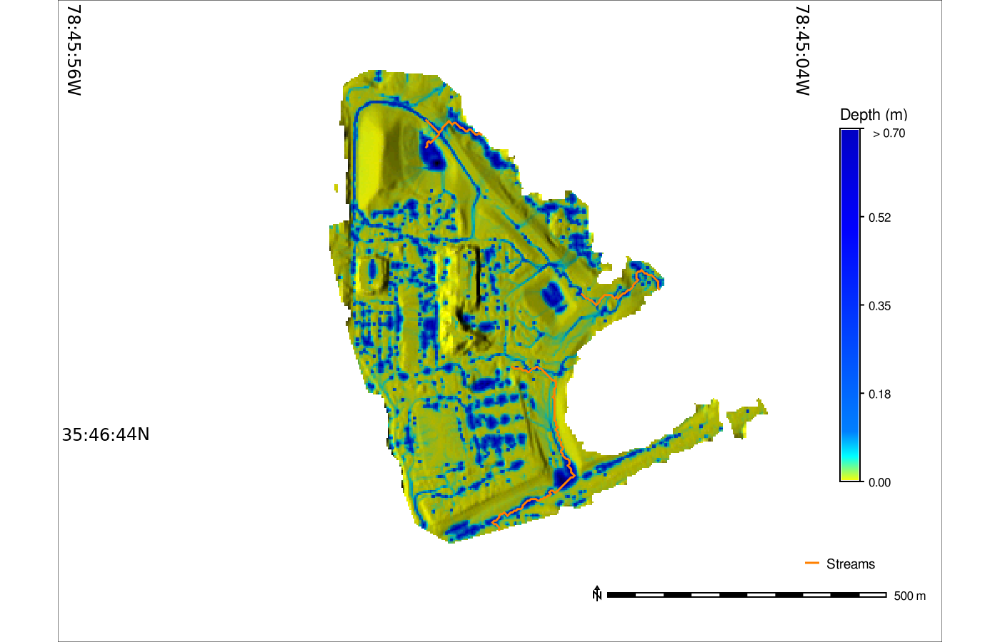

In [4949]:
# gs.run_command("g.region", raster="fenton_bare_earth_fused", res=3, flags="pa")
# analyze_hydrology(
#     dem="bare_earth", 
#     uas=False, 
#     fused=False, 
#     drainage="bare_earth_direction_3k", 
#     stream="bare_earth_streams_3k",
#     basin="bare_earth_basins_3k",
#     accumulation="bare_earth_accum_3k",
#     threshold=3000, 
#     overwrite=True
# )

# !v.select -c --overwrite ainput=bare_earth_streams_3k_ext binput=fenton_3m_fused_basin_3k output=bare_earth_pre_fusion_stream operator=within
# gs.run_command("r.relief", input="bare_earth", output="bare_earth_relief", overwrite=True)
# gs.run_command("r.shade", shade="bare_earth_relief", color="depth_bare_earth.60", output="depth_bare_earth_60_shaded_relief", overwrite=True)
gs.run_command("g.region", region="site_1", res=3, flags="pa")
fenton_fused_depth_map = gj.GrassRenderer(height=900, width=1400, filename="output/bare_earth_depth_map.png")
fenton_fused_depth_map.d_erase()
fenton_fused_depth_map.d_rast(map="depth_bare_earth_60_shaded_relief")
fenton_fused_depth_map.d_vect(map="bare_earth_pre_fusion_stream", color="orange", type="line", width=3, legend_label="Streams")
# fenton_fused_depth_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=4, legend_label="Priority Queue")
# fenton_fused_depth_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Overlap")
# fenton_fused_depth_map.d_vect(map="fenton_3m_fused_basin_3k", fill_color="none", color="black", width="1", flags="s")

depth_univ = gs.parse_command("r.univar", map="depth_bare_earth.60", flags="ge")
print(f"depth stats: {depth_univ}")
fenton_fused_depth_map.d_legend(raster="depth_bare_earth.60", 
                                range=(0.0,0.7),
                                at=(80,25,84,86), 
                                border_color="none", 
                                title="Depth (m)",title_fontsize=16, 
                                fontsize=12, font="FreeSans", 
                                flags="tsbf")
fenton_fused_depth_map.d_legend_vect(at=(80.5,14),font="FreeSans", flags="b",border_color="none")

fenton_fused_depth_map.d_text(at=(92.2,78.65),text="> 0.70", bgcolor="white",font="FreeSans",size=1.75, color="black")

fenton_fused_depth_map.d_barscale(at=(59,9),units="kilometers",font="FreeSans",flags="n")
fenton_fused_depth_map.d_grid(size="00:00:52", flags="dw", width=1, color="black",text_color="black",fontsize=24)

fenton_fused_depth_map.show()

### USGS NED DEM

depth stats: {'n': '180480', 'null_cells': '0', 'cells': '180480', 'min': '0.00095128221437335', 'max': '2.19864749908447', 'range': '2.1976962168701', 'mean': '0.0591328568860572', 'mean_of_abs': '0.0591328568860572', 'stddev': '0.147484231147479', 'variance': '0.0217515984371629', 'coeff_var': '249.411645088728', 'sum': '10672.2980107956', 'first_quartile': '0.00556623', 'median': '0.00958447', 'third_quartile': '0.0245256', 'percentile_90': '0.166909'}


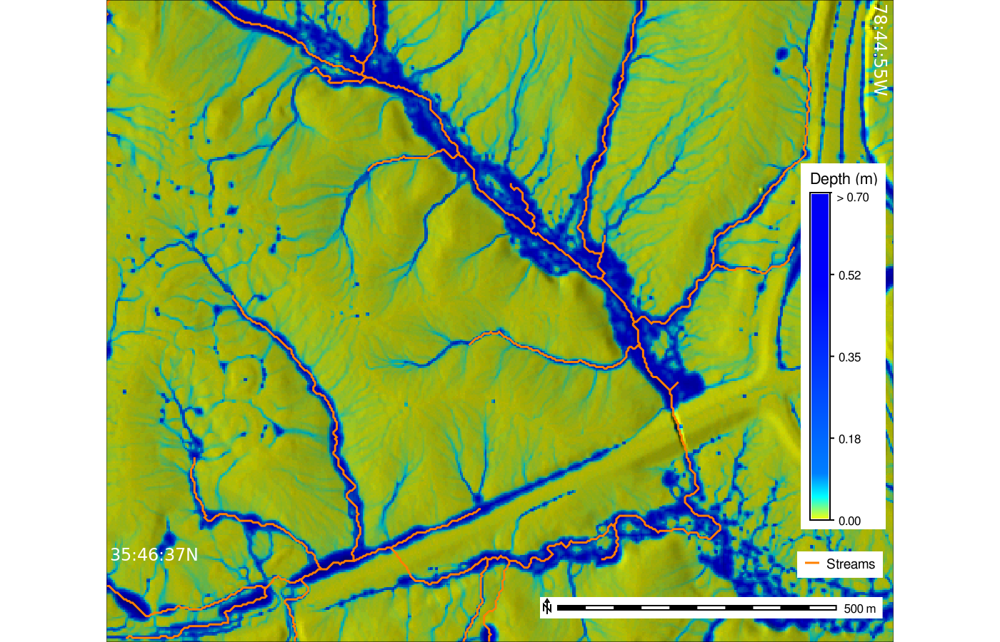

In [4952]:
# gs.run_command("g.region", raster="fenton_bare_earth_fused", res=3, flags="pa")
# analyze_hydrology(
#     dem="ned_19sec_site_priority_1", 
#     uas=False, 
#     fused=False, 
#     drainage="ned_19sec_fenton_basin_direction_3k", 
#     stream="ned_19sec_fenton_basin_streams_3k",
#     basin="ned_19sec_fused_fenton_basin_basins_3k",
#     accumulation="ned_19sec_fused_fenton_basin_accum_3k",
#     threshold=3000, 
#     overwrite=True
# )

# !v.select -c --overwrite ainput=ned_19sec_fenton_basin_streams_3k_ext binput=fenton_3m_fused_basin_3k output=pre_fusion_stream operator=within
# gs.run_command("r.shade", shade="ned_19sec_relief", color="depth_ned_19sec.60", output="depth_ned_19sec_60_shaded_relief", overwrite=True)
gs.run_command("g.region", region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 175
view_reg_e = view_reg['e'] + 145

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               # e=view_reg_e,
               res=3, flags="pa")

fenton_pre_fused_depth_map = gj.GrassRenderer(height=900, width=1400,filename="output/fenton_pre_fused_depth_map.png")
fenton_pre_fused_depth_map.d_erase()
fenton_pre_fused_depth_map.d_rast(map="depth_ned_19sec_60_shaded_relief")
fenton_pre_fused_depth_map.d_vect(map="pre_fusion_stream", color="orange",type="line", width=3,  legend_label="Streams")
# fenton_pre_fused_depth_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=4, legend_label="Priority Queue")
# fenton_pre_fused_depth_map.d_vect(map="fenton_3m_fused_basin_3k", fill_color="none", color="black", width="1", flags="s")
# fenton_pre_fused_depth_map.d_legend_vect(at=(60,95,70,70),font="FreeSans", flags="b")
# fenton_pre_fused_depth_map.d_legend(raster="depth_ned_19sec.60", at=(65,25,77,80), title="Depth (m)",title_fontsize=16, fontsize=12, font="FreeSans", flags="lb")
# fenton_pre_fused_depth_map.d_barscale(at=(54,9,70,80), units="kilometers", fontsize=14, font="FreeSans")
fenton_pre_fused_depth_map.d_legend_vect(at=(80.5,14),font="FreeSans", flags="b",border_color="none")


depth_univ = gs.parse_command("r.univar", map="depth_ned_19sec.60", flags="ge")
print(f"depth stats: {depth_univ}")
fenton_pre_fused_depth_map.d_legend(raster="depth_ned_19sec.60", 
                                range=(0.0,0.7),
                                at=(70,19,81,83), 
                                border_color="none", 
                                title="Depth (m)",title_fontsize=16, 
                                fontsize=12, font="FreeSans", 
                                flags="tsbf")

fenton_pre_fused_depth_map.d_text(at=(92.8,68.65),text="> 0.70", bgcolor="white",font="FreeSans",size=1.75, color="black")

fenton_pre_fused_depth_map.d_barscale(at=(54,7),units="kilometers",font="FreeSans",flags="n")
fenton_pre_fused_depth_map.d_grid(size="00:00:59", flags="dw", width=1, color="black",text_color="white",fontsize=24)

fenton_pre_fused_depth_map.show()

### Fused DEM

depth stats: {'n': '180480', 'null_cells': '0', 'cells': '180480', 'min': '0.000571778800804168', 'max': '2.38359427452087', 'range': '2.38302249572007', 'mean': '0.0572491017930036', 'mean_of_abs': '0.0572491017930036', 'stddev': '0.145017221324768', 'variance': '0.0210299944807566', 'coeff_var': '253.309164306382', 'sum': '10332.3178916013', 'first_quartile': '0.00465947', 'median': '0.00878744', 'third_quartile': '0.0240012', 'percentile_90': '0.164806'}


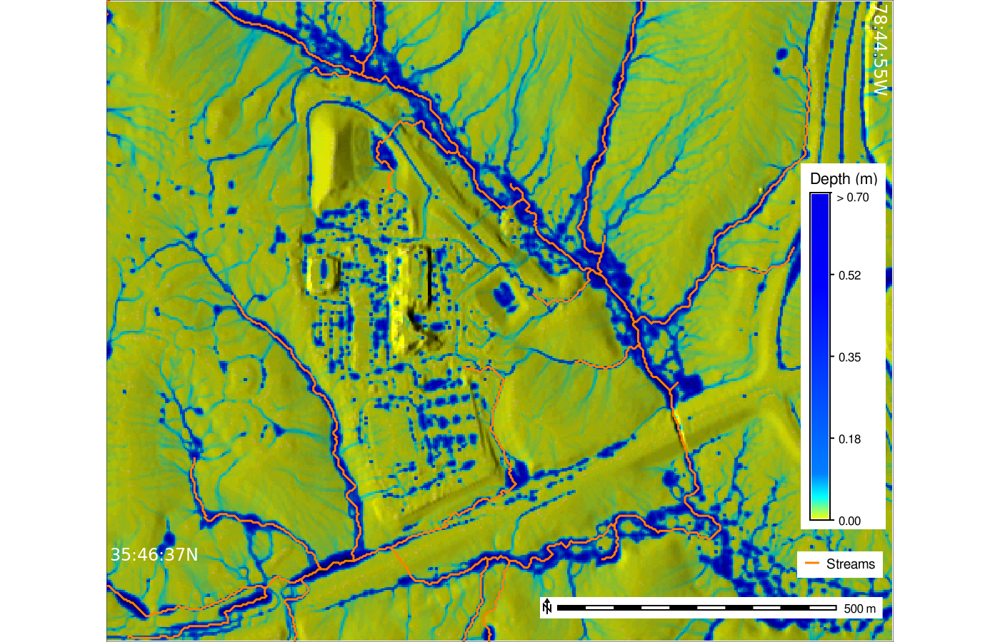

In [4938]:
# gs.run_command("g.region", raster="fenton_bare_earth_fused", res=3, flags="pa")
# analyze_hydrology(
#     dem="fenton_bare_earth_fused", 
#     uas=False, 
#     fused=False, 
#     drainage="fenton_bare_earth_fused_direction_3k", 
#     stream="fenton_bare_earth_fused_streams_3k",
#     basin="fenton_bare_earth_fused_basins_3k",
#     accumulation="fenton_bare_earth_fused_fused_accum_3k",
#     threshold=3000, 
#     overwrite=True
# )

# !v.select -c --overwrite ainput=fenton_bare_earth_fused_streams_3k_ext binput=fenton_3m_fused_basin_3k output=post_fusion_stream operator=within
# gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="depth_fenton_bare_earth_fused.60", output="depth_fenton_bare_earth_fused_60_shaded_relief", overwrite=True)
gs.run_command("g.region", region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 175
view_reg_e = view_reg['e'] + 145

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               # e=view_reg_e,
               res=3, flags="pa")
fenton_fused_depth_map = gj.GrassRenderer(height=900, width=1400, filename="output/fenton_fused_depth_map.png")
fenton_fused_depth_map.d_erase()
fenton_fused_depth_map.d_rast(map="depth_fenton_bare_earth_fused_60_shaded_relief")
fenton_fused_depth_map.d_vect(map="post_fusion_stream", color="orange", type="line", width=3, legend_label="Streams")
# fenton_fused_depth_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=4, legend_label="Priority Queue")
# fenton_fused_depth_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Overlap")
# fenton_fused_depth_map.d_vect(map="fenton_3m_fused_basin_3k", fill_color="none", color="black", width="1", flags="s")

fenton_fused_depth_map.d_legend_vect(at=(80.5,14),font="FreeSans", flags="b",border_color="none")
depth_univ = gs.parse_command("r.univar", map="depth_fenton_bare_earth_fused.60", flags="ge")
print(f"depth stats: {depth_univ}")
# fenton_fused_depth_map.d_legend(raster="depth_fenton_bare_earth_fused.60", 
#                                 range=(0.0,0.7),
#                                 at=(80,25,84,86), 
#                                 border_color="none", 
#                                 title="Depth (m)",title_fontsize=16, 
#                                 fontsize=12, font="FreeSans", 
#                                 flags="tsbf")

# fenton_fused_depth_map.d_text(at=(92.2,78.65),text="> 0.70", bgcolor="white",font="FreeSans",size=1.75, color="black")
fenton_fused_depth_map.d_legend(raster="depth_fenton_bare_earth_fused.60", 
                                range=(0.0,0.7),
                                at=(70,19,81,83), 
                                border_color="none", 
                                title="Depth (m)",title_fontsize=16, 
                                fontsize=12, font="FreeSans", 
                                flags="tsbf")

fenton_fused_depth_map.d_text(at=(92.8,68.65),text="> 0.70", bgcolor="white",font="FreeSans",size=1.75, color="black")

fenton_fused_depth_map.d_barscale(at=(54,7),units="kilometers",font="FreeSans",flags="n")
fenton_fused_depth_map.d_grid(size="00:00:59", flags="dw", width=1, color="black",text_color="white",fontsize=24)

fenton_fused_depth_map.show()

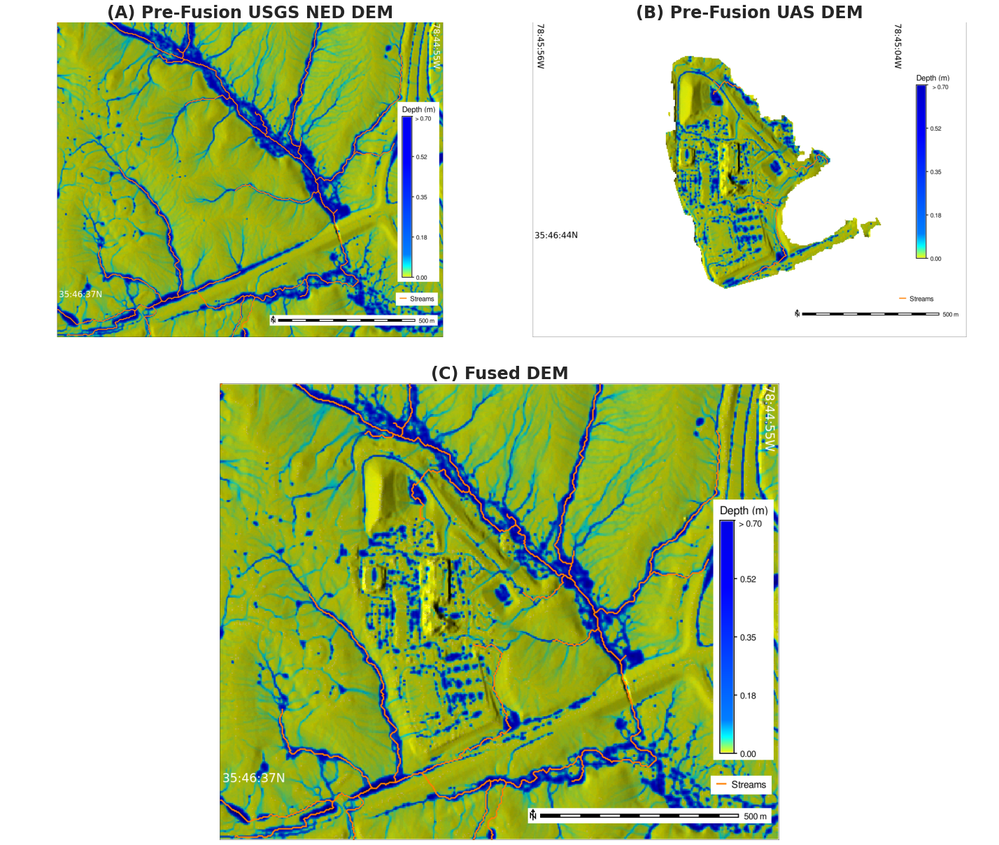

In [4953]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

# ax = fig.add_subplot(2, 1, 1)

grs = fig.add_gridspec(2, 2)
ax1 = fig.add_subplot(grs[0, 0])
ax1.set_axis_off()

img1 = Image.open("output/fenton_pre_fused_depth_map.png")
imgplot = plt.imshow(img1)
ax1.set_title('(A) Pre-Fusion USGS NED DEM',{"fontsize":24, "fontweight":"bold"})


ax2 = fig.add_subplot(grs[0, 1])
ax2.set_axis_off()

img1 = Image.open("output/bare_earth_depth_map.png")
imgplot = plt.imshow(img1)
ax2.set_title('(B) Pre-Fusion UAS DEM',{"fontsize":24, "fontweight":"bold"})
# spans two rows:
ax3 = fig.add_subplot(grs[1, :])
ax3.set_axis_off()

fig.subplots_adjust(hspace=0, wspace=0.1)


# ax = fig.add_subplot(2, 1, 2)
# ax.set_axis_off()
img2 = Image.open("output/fenton_fused_depth_map.png")
imgplot = plt.imshow(img2)
ax3.set_title('(C) Fused DEM',{"fontsize":24, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/fenton_basin_fusion_depth.png",bbox_inches='tight', dpi=300)

#### Fusion Depth - USGS Depth

depth_diff_fusion_usgs: Mean: -0.00362857477788956, STD: 0.0678677828580513, Median: -0.000625148, Min: -0.996213436126709, Max: 1.44697606563568


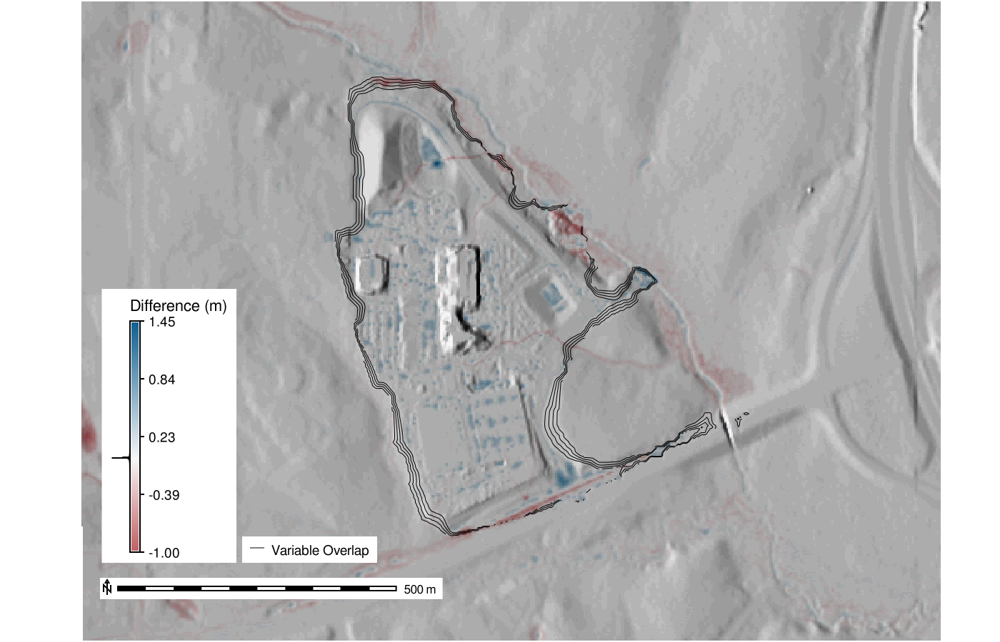

In [3521]:

# gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fusion_depth_diff = "depth_diff_fusion_usgs"
gs.mapcalc(f"{fusion_depth_diff} = depth_fenton_bare_earth_fused.60 - depth_ned_19sec.60")
# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
gs.run_command("r.colors",map=fusion_depth_diff, rules="grass_config/fusion_depth_diff_colors.txt", flags="n")
depth_shaded_releif = f"{fusion_depth_diff}_shaded_relief"
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color=fusion_depth_diff, output=depth_shaded_releif, overwrite=True)
report_diff_stats(fusion_depth_diff)

gs.run_command("g.region",region="site_1", res=3, flags="pa")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename=f"output/{fusion_depth_diff}.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map=depth_shaded_releif)
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(25,16.25),font="FreeSans", flags="b",border_color="none")

fenton_bare_earth_fused_diff_map.d_legend(raster=fusion_depth_diff,
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()


#### Fusion Depth - UAS Bare Earth Depth

depth_diff_fusion_usa: Mean: 0.0112460358990462, STD: 0.0978957161301291, Median: -0.000507713, Min: -0.632968246936798, Max: 1.24882805347443


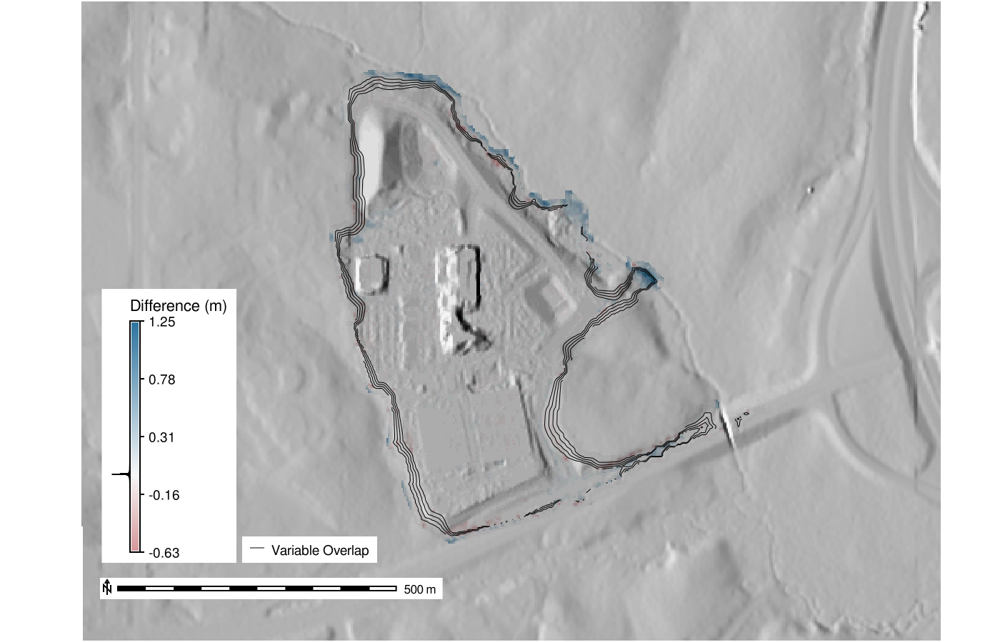

In [3522]:
# gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fusion_depth_diff = "depth_diff_fusion_usa"
gs.mapcalc(f"{fusion_depth_diff} = depth_fenton_bare_earth_fused.60 - depth_bare_earth.60")
# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
gs.run_command("r.colors",map=fusion_depth_diff, rules="grass_config/fusion_depth_diff_colors.txt", flags="n")
depth_shaded_releif = f"{fusion_depth_diff}_shaded_relief"
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color=fusion_depth_diff, output=depth_shaded_releif, overwrite=True)
report_diff_stats(fusion_depth_diff)

gs.run_command("g.region",region="site_1", res=3, flags="pa")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename=f"output/{fusion_depth_diff}.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map=depth_shaded_releif)
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(25,16.25),font="FreeSans", flags="b",border_color="none")

fenton_bare_earth_fused_diff_map.d_legend(raster=fusion_depth_diff,
                                             at=(14,50,13,14),
                                             title="Difference (m)", title_fontsize=16, border_color="none",
                                             fontsize=14, font="FreeSans",
                                             flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(10,10), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.show()

#### Basin Comparison

In [ ]:
def generate_depth_map(depth, flooding, filename, relief, depth_filter=0.075):
    """
    @param depth_filter : float : 0.075m is ~0.25ft
    """
    print(f"Flooding Depth: {flooding}")
    expression = f"{flooding} = if({depth} >= {depth_filter},  {depth}, null())"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=flooding, raster=depth)
    print(f"Image Save Location: {output}")
    output = f"output/{flooding}.png"
    print(f"Image Save Location: {output}")

    flooding_map = gj.GrassRenderer(height=900,width=1400,filename=output)
    flooding_map.d_erase()
    flooding_map.d_rast(map=relief)
    flooding_map.d_rast(map=flooding)
    flooding_map.d_legend(raster=flooding, at=(10,50,2,6), title="Depth (m)",flags="l")
    flooding_map.d_barscale(at=(1,6,2,2), units="meters", flags="n")
    return flooding_map.show()

generate_depth_map()

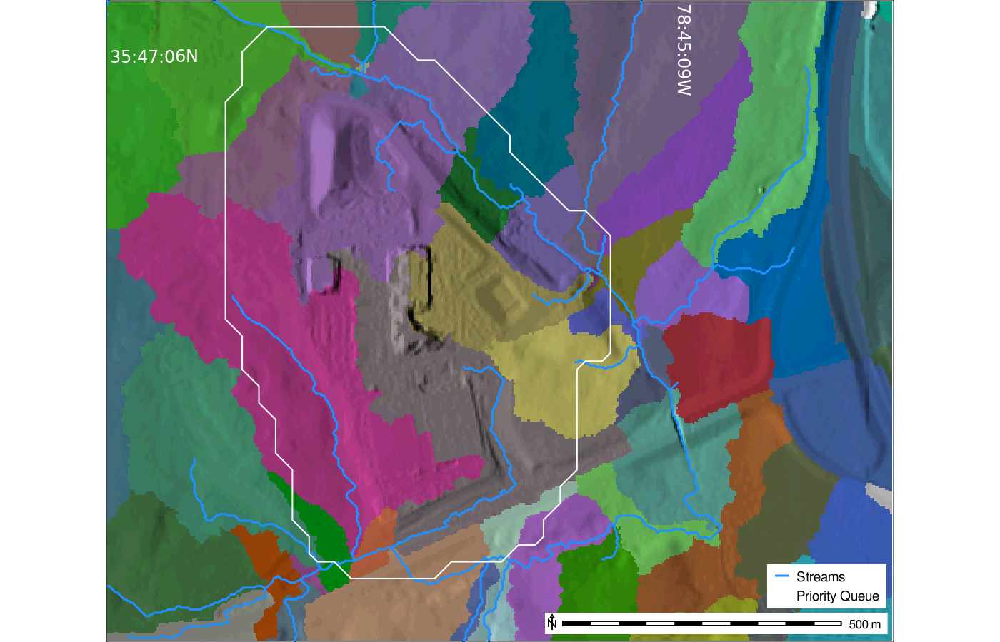

In [4961]:
# fenton_bare_earth_fused_basins_3k
# ned_19sec_fused_fenton_basin_basins_3k
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
# !r.cross input=fenton_bare_earth_fused_basins_3k,ned_19sec_fused_fenton_basin_basins_3k output=fusion_usgs_basins_cross
# gs.mapcalc(f"{fusion_depth_diff} = if(fenton_bare_earth_fused_basins_3k == ned_19sec_fused_fenton_basin_basins_3k )")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fusion_depth_diff = "fenton_bare_earth_fused_basins_3k"
# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
# gs.run_command("r.colors",map=fusion_depth_diff, rules="grass_config/fusion_depth_diff_colors.txt", flags="n")
depth_shaded_releif = f"{fusion_depth_diff}_shaded_relief"
gs.run_command("r.shade", shade="fenton_bare_earth_fused_relief", color="fenton_bare_earth_fused_basins_3k", output=depth_shaded_releif, overwrite=True)
# flooding= "fused_flooding"
# depth = "depth_fenton_bare_earth_fused.60" # - depth_ned_19sec.60
# expression = f"{flooding} = if({depth} >= 0.03,  {depth}, null())"
# gs.run_command("r.mapcalc", expression=expression, overwrite=True)
# gs.run_command("r.colors", map=flooding, raster=depth)

gs.run_command("g.region",region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 175
view_reg_e = view_reg['e'] + 145

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               # e=view_reg_e,
               res=3, flags="pa")

fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename=f"output/{fusion_depth_diff}.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="fenton_bare_earth_fused_relief")
fenton_bare_earth_fused_diff_map.d_rast(map=depth_shaded_releif)
# fenton_bare_earth_fused_diff_map.d_rast(map=flooding)
# fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")
fenton_bare_earth_fused_diff_map.d_vect(map="post_fusion_stream", color="30:144:255:255",type="line", width=3,  legend_label="Streams")
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=2, legend_label="Priority Queue")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(77.5,12),font="FreeSans", flags="b",border_color="none")

# fenton_bare_earth_fused_diff_map.d_legend(raster=fusion_depth_diff,
#                                              at=(14,50,13,14),
#                                              title="Difference (m)", title_fontsize=16, border_color="none",
#                                              fontsize=14, font="FreeSans",
#                                              flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(54.5,4.5), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.d_grid(size="00:00:51", flags="dw", width=1, color="black",text_color="white",fontsize=24)

fenton_bare_earth_fused_diff_map.show()

ned_19sec_fused_fenton_basin_basins_3k: Mean: 63.7242111287428, STD: 29.4101782687402, Median: 66.0, Min: 4.0, Max: 120.0


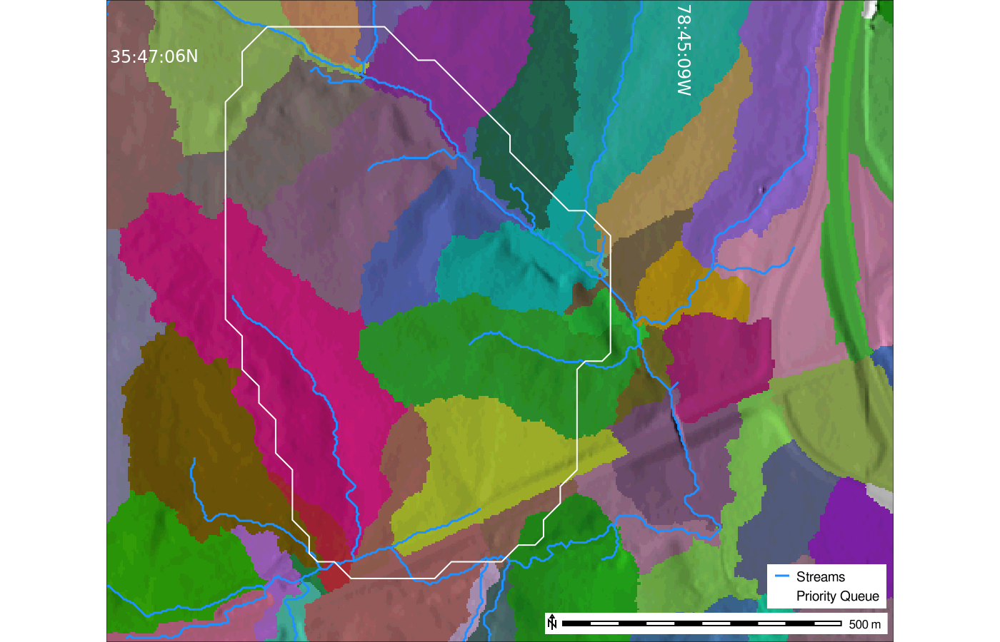

In [4962]:
# fenton_bare_earth_fused_basins_3k
# ned_19sec_fused_fenton_basin_basins_3k
gs.run_command("g.region",raster="fenton_bare_earth_fused", res=3, flags="pa")
# !r.cross input=fenton_bare_earth_fused_basins_3k,ned_19sec_fused_fenton_basin_basins_3k output=fusion_usgs_basins_cross
# gs.mapcalc(f"{fusion_depth_diff} = if(fenton_bare_earth_fused_basins_3k == ned_19sec_fused_fenton_basin_basins_3k )")
gs.run_command("g.region",region="site_1", res=3, flags="pa")
fusion_depth_diff = "ned_19sec_fused_fenton_basin_basins_3k"
# Calculated during fusion process (fenton_bare_earth_fused_diff)
# gs.mapcalc(f"fenton_bare_earth_fused_diff = if(fenton_bare_earth_fused, fenton_bare_earth_fused - ned_19sec_site_priority_1, null())")
# gs.run_command("r.colors",map=fusion_depth_diff, rules="grass_config/fusion_depth_diff_colors.txt", flags="n")
depth_shaded_releif = f"{fusion_depth_diff}_shaded_relief"
gs.run_command("r.shade", shade="ned_19sec_relief", color="ned_19sec_fused_fenton_basin_basins_3k", output=depth_shaded_releif, overwrite=True)
report_diff_stats(fusion_depth_diff)

gs.run_command("g.region",region="site_1", res=3, flags="pa")
view_reg = gs.region("site_1")
view_reg_w = view_reg['w'] + 175
view_reg_e = view_reg['e'] + 145

gs.run_command("g.region",
               region="site_1",
               w=view_reg_w,
               # e=view_reg_e,
               res=3, flags="pa")
fenton_bare_earth_fused_diff_map = gj.GrassRenderer(height=900, width=1400,filename=f"output/{fusion_depth_diff}.png")
fenton_bare_earth_fused_diff_map.d_erase()
fenton_bare_earth_fused_diff_map.d_rast(map="ned_19sec_relief")
fenton_bare_earth_fused_diff_map.d_rast(map=depth_shaded_releif)
# fenton_bare_earth_fused_diff_map.d_vect(map="fenton_bare_earth_fused_overlap_contours",fill_color="none", color="black", width="0.5", legend_label="Variable Overlap")
fenton_bare_earth_fused_diff_map.d_vect(map="pre_fusion_stream", color="30:144:255:255",type="line", width=3,  legend_label="Streams")
fenton_bare_earth_fused_diff_map.d_vect(map="fenton_pq_boundary", fill_color="none", color="white", width=2, legend_label="Priority Queue")

fenton_bare_earth_fused_diff_map.d_legend_vect(at=(77.5,12),font="FreeSans", flags="b",border_color="none")

# fenton_bare_earth_fused_diff_map.d_legend(raster=fusion_depth_diff,
#                                              at=(14,50,13,14),
#                                              title="Difference (m)", title_fontsize=16, border_color="none",
#                                              fontsize=14, font="FreeSans",
#                                              flags="btd")
fenton_bare_earth_fused_diff_map.d_barscale(at=(54.5,4.5), units="meters",font="FreeSans", flags="n")
fenton_bare_earth_fused_diff_map.d_grid(size="00:00:51", flags="dw", width=1, color="black",text_color="white",fontsize=24)
fenton_bare_earth_fused_diff_map.show()

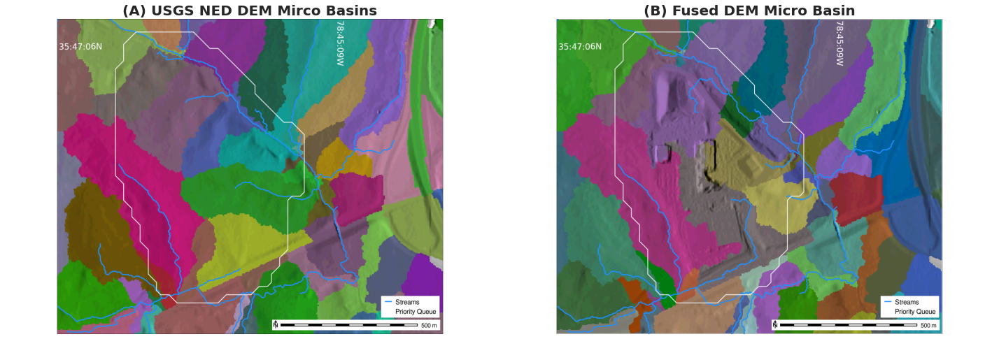

In [4963]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

ax = fig.add_subplot(1, 2, 1)
fig.subplots_adjust(hspace=0, wspace=0.1)
ax.set_axis_off()
img1 = Image.open("output/ned_19sec_fused_fenton_basin_basins_3k.png")
imgplot = plt.imshow(img1)
ax.set_title('(A) USGS NED DEM Mirco Basins',{"fontsize":20, "fontweight":"bold"})

ax = fig.add_subplot(1, 2, 2)
ax.set_axis_off()
img2 = Image.open("output/fenton_bare_earth_fused_basins_3k.png")
imgplot = plt.imshow(img2)
ax.set_title('(B) Fused DEM Micro Basin',{"fontsize":20, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/pre_post_fusion_basins.png",bbox_inches='tight',dpi=300)

# Compare Results

### Create Before after watersheds and streams to compare effects of fusion

In [401]:
def subtract(before, after, output, shade="cary_flight_2_odm_dtm_3m_fused_relief"):
    expression = f"{output} = {after} - {before}"
    gs.run_command("r.mapcalc", expression=expression, overwrite=True)
    gs.run_command("r.colors", map=output, color="differences", flags="")
    #Shaded Relief Map
    output2=f"{output}_relief_shaded"
    gs.run_command("r.shade", shade=shade, color=output, output=output2, overwrite=True)

In [ ]:
gs.run_command("g.region",raster="depth_ned_19sec_site_priority_1.60", res=3, flags="pa")

subtract(
    before="depth_ned_19sec_site_priority_1.60",
    after="depth_cary_town_blvd_flight_1_odm_dtm_3m_fused.60",
    output="depth_cary_town_blvd_sub_flight_1_odm_dtm_3m_fused_60",
    shade="cary_town_blvd_flight_1_odm_dtm_3m_fused_relief")

depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map = gj.GrassRenderer(filename="output/depth_fenton_sub_ned_f1_odm_dtm_3m_fused_60.png")
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_erase()
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_rast(map="depth_cary_town_blvd_sub_flight_1_odm_dtm_3m_fused_60_relief_shaded")
# depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_vect(map="wc_ned_19sec_fenton_flight_1_odm_dtm_3m_fused_basins_3k", fill_color="none", legend_label="Subwatersheds")
# depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_vect(map="wc_ned_19sec_fenton_flight_1_odm_dtm_3m_fused_streams_3k_ext", color="blue", type="line", width=1, legend_label="Post-Fusion Streams")
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_legend(raster="depth_cary_town_blvd_sub_flight_1_odm_dtm_3m_fused_60", at=(12,60,2,5),title="Depth (m)", title_fontsize=10)
# depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_legend_vect(at=(2,9,2,6),fontsize=10,flags="b", bgcolor="white", border_width=1)
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.d_barscale(at=(2,7,100,100), units="meters", flags="n")
depth_cf_sub_ned_f1_odm_dtm_3m_fused_60_map.show()

# Compare USGS DEM to Fusion geomorphology

# Compare NLCD 2016 with 2019

{'0 road 8100.000000 9 3.56%': None, '3 forest 222300.000000 247 97.63%': None}


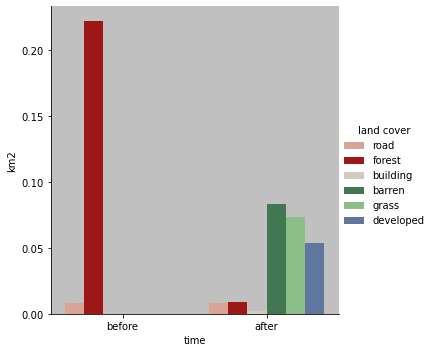

In [544]:
gs.run_command("g.region",raster="cary_town_blvd_flight_1_odm_dtm_3m_pmask", res=30, flags="pa")

gs.run_command("r.mask", raster="cary_town_blvd_flight_1_odm_dtm_3m_pmask", overwrite=True)
before_class_stats = gs.parse_command("r.stats", input="classified_before_30m_recl", flags="acpln")
after_class_stats = gs.parse_command("r.stats", input="classified_after_30m_recl", flags="acpln")

landcover_dict = {"class":[] , "land cover":[], "m2":[], "cells":[], "percent":[], "time":[] }
print(before_class_stats)
for k in before_class_stats.keys():
    row = k.split(" ") 
    row.append("before")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])

for k in after_class_stats.keys():
    row = k.split(" ")
    row.append("after")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])  

df_landcover = pd.DataFrame(landcover_dict)
df_landcover.head(10)
df_landcover['km2'] = df_landcover['m2'].apply(pd.to_numeric) / 1e6
landcover_color_palette = [
    'E29E8C', # Class 0 - road/highways         NLCD class color 22
    'B50000', # Class 1 - Building dark red     NLCD class color 24
    'D2CDC0', # Class 2 - barren                NLCD class color 31
    '38814E', # Class 3 - Forest                NLCD class color 42
    '85C77E', # Class 4 - Grass                 NLCD class color 41
    '5475A8', # Class 5 -  water                 NLCD class color 11
    'E8D1D1' # Class 5 -  developed             NLCD class color 21
]
sns.catplot(x="time", y="km2", hue="land cover", data=df_landcover, kind="bar", palette=sns.color_palette([ "#%s" % c for c in landcover_color_palette]))

In [545]:
df_landcover.head(10)

,class,land cover,m2,cells,percent,time,km2
0,0,road,8100.000000,9,3.56%,before,0.0081
1,3,forest,222300.000000,247,97.63%,before,0.2223
2,0,road,8100.000000,9,3.61%,after,0.0081
3,1,building,1800.000000,2,0.80%,after,0.0018
4,2,barren,83700.000000,93,37.35%,after,0.0837
5,3,forest,9000.000000,10,4.02%,after,0.0090
6,4,grass,73800.000000,82,32.93%,after,0.0738
7,6,developed,54000.000000,60,24.10%,after,0.0540


In [546]:
df_landcover_p = pd.pivot_table(df_landcover, values='km2', index=['land cover'], columns=['time'], aggfunc=np.sum) #.pct_change(axis='columns')
df_landcover_p['% change'] = df_landcover_p.apply(lambda r : ((r['after'] - r['before'])/r['before']) * 100, axis = 1)
df_landcover_p.reset_index().head()

time,land cover,after,before,% change
0,barren,0.0837,NaN,NaN
1,building,0.0018,NaN,NaN
2,developed,0.0540,NaN,NaN
3,forest,0.0090,0.2223,-95.951417
4,grass,0.0738,NaN,NaN


### Evaluate with pandas

Color table for raster map <nlcd_2016_recl> set to 'nlcd'
Color table for raster map <nlcd_2019_recl> set to 'nlcd'
{'11|Open Water|1269000.000000|1410|1.07%': None, '21|Developed (Open Space)|38799900.000000|43111|32.64%': None, '22|Developed (Low Intensity)|22307400.000000|24786|18.77%': None, '23|Developed (Medium Intensity)|14373900.000000|15971|12.09%': None, '24|Developed (High Intensity)|4059000.000000|4510|3.41%': None, '31|Barren Land|1181700.000000|1313|0.99%': None, '41|Deciduous Forest|8063100.000000|8959|6.78%': None, '42|Evergreen Forest|8843400.000000|9826|7.44%': None, '43|Mixed Forest|9930600.000000|11034|8.35%': None, '52|Shrub/Scrub|721800.000000|802|0.61%': None, '71|Grassland/Herbaceous|1474200.000000|1638|1.24%': None, '81|Pasture/Hay|2786400.000000|3096|2.34%': None, '82|Cultivated Crops|385200.000000|428|0.32%': None, '90|Woody Wetlands|4502700.000000|5003|3.79%': None, '95|Emergent Herbaceous Wetlands|182700.000000|203|0.15%': None}
Type: <class 'str'>, class: 

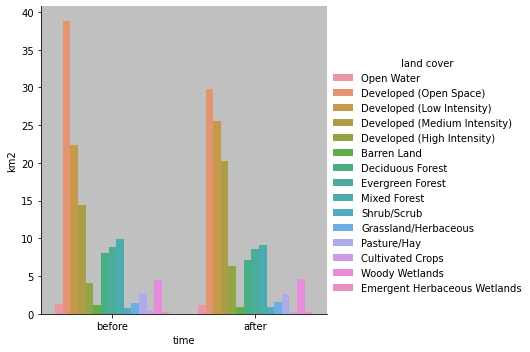

In [587]:
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
gs.run_command("g.region", raster="walnut_creek", res=30, flags="pa")
gs.run_command("r.mask", raster="walnut_creek", overwrite=True)
before_class_stats = gs.parse_command("r.stats", input="nlcd_2016_recl", flags="acpln", separator="|")
after_class_stats = gs.parse_command("r.stats", input="nlcd_2019_recl", flags="acpln", separator="|")

landcover_dict = {"class":[] , "land cover":[], "m2":[], "cells":[], "percent":[], "time":[] }
print(before_class_stats)
for k in before_class_stats.keys():
    row = k.split("|") 
    row.append("before")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])

for k in after_class_stats.keys():
    row = k.split("|")
    row.append("after")
    for i, col in enumerate(landcover_dict.keys()):
        landcover_dict[col].append(row[i])  

df_nlcd = pd.DataFrame(landcover_dict)
df_nlcd.head(10)
df_nlcd['km2'] = df_nlcd['m2'].apply(pd.to_numeric) / 1e6
# landcover_color_palette = [
#     'E29E8C', # Class 0 - road/highways         NLCD class color 22
#     'B50000', # Class 1 - Building dark red     NLCD class color 24
#     'D2CDC0', # Class 2 - barren                NLCD class color 31
#     '38814E', # Class 3 - Forest                NLCD class color 42
#     '85C77E', # Class 4 - Grass                 NLCD class color 41
#     '5475A8', # Class 5 -  water                 NLCD class color 11
#     'E8D1D1' # Class 5 -  developed             NLCD class color 21
# ]
sns.catplot(x="time", y="km2", hue="land cover", data=df_nlcd, kind="bar" ) #, palette=sns.color_palette([ "#%s" % c for c in landcover_color_palette]))

In [591]:
df_nlcd.head(50)

,class,land cover,m2,cells,percent,time,km2
0,11,Open Water,1269000.000000,1410,1.07%,before,1.2690
1,21,Developed (Open Space),38799900.000000,43111,32.64%,before,38.7999
2,22,Developed (Low Intensity),22307400.000000,24786,18.77%,before,22.3074
3,23,Developed (Medium Intensity),14373900.000000,15971,12.09%,before,14.3739
4,24,Developed (High Intensity),4059000.000000,4510,3.41%,before,4.0590
5,31,Barren Land,1181700.000000,1313,0.99%,before,1.1817
6,41,Deciduous Forest,8063100.000000,8959,6.78%,before,8.0631
7,42,Evergreen Forest,8843400.000000,9826,7.44%,before,8.8434
8,43,Mixed Forest,9930600.000000,11034,8.35%,before,9.9306
9,52,Shrub/Scrub,721800.000000,802,0.61%,before,0.7218


In [601]:
df_nlcd[df_nlcd['time'] == 'after']['km2'].sum()

118.881

In [596]:
df_nlcd_p = pd.pivot_table(df_nlcd, values='km2', index=['land cover'], columns=['time'], aggfunc=np.sum) #.pct_change(axis='columns')
df_nlcd_p['% change'] = df_nlcd_p.apply(lambda r : ((r['after'] - r['before'])/r['before']) * 100, axis = 1)
# df_nlcd_p = df_nlcd_p[['land cover', 'before', 'after','% change']]
df_nlcd_p.reset_index().sort_values(by="% change").head(50)

time,land cover,after,before,% change
1,Cultivated Crops,0.2871,0.3852,-25.467290
0,Barren Land,0.8991,1.1817,-23.914699
6,Developed (Open Space),29.7369,38.7999,-23.358308
2,Deciduous Forest,7.1307,8.0631,-11.563791
11,Open Water,1.1340,1.2690,-10.638298
10,Mixed Forest,9.0621,9.9306,-8.745695
12,Pasture/Hay,2.6442,2.7864,-5.103359
8,Evergreen Forest,8.5968,8.8434,-2.788520
14,Woody Wetlands,4.5837,4.5027,1.798921
9,Grassland/Herbaceous,1.5372,1.4742,4.273504


In [614]:
!r.coin first=nlcd_2016_recl second=nlcd_2019_recl units=k -w

Tabulating Coincidence between 'nlcd_2016_recl' and 'nlcd_2019_recl'
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100

+------------------------------------------------------------------------------+
|                        COINCIDENCE TABULATION REPORT                         |
|------------------------------------------------------------------------------|
| Location: nc_spm_08_gras  Mapset: rapid-dsm        Date: Thu Dec 16 12:27:40 |
|                                                                              |
| Layer 1: nlcd_2016_recl -- NLCD 2016                                         |
| Layer 2: nlcd_2019_recl -- NLCD 2019                                         |
| Mask:    <walnut_creek> in mapset <rapid-dsm>                                |
|                                                                              |
| Units:   square kilometers                                

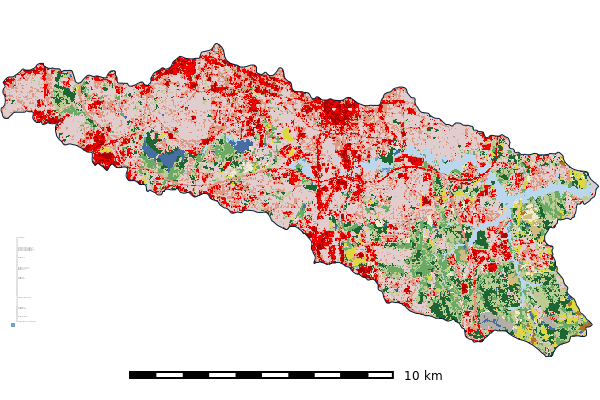

In [605]:
nlcd_2016_map = gj.GrassRenderer(filename="output/nlcd_2016_map.png")
nlcd_2016_map.d_erase()
nlcd_2016_map.d_rast(map="nlcd_2016_recl")
nlcd_2016_map.d_vect(map="walnut_creek", fill_color="none")
nlcd_2016_map.d_legend(raster="nlcd_2016_recl", at=(2,40,2,6))
nlcd_2016_map.d_barscale(at=(20,10,12,10), units="kilometers")
nlcd_2016_map.show()

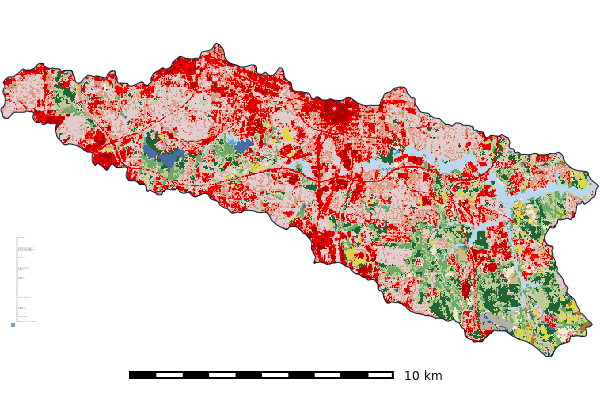

In [604]:
nlcd_2019_map = gj.GrassRenderer(filename="output/nlcd_2019_map.png")
nlcd_2019_map.d_erase()
nlcd_2019_map.d_rast(map="nlcd_2019_recl")
nlcd_2019_map.d_vect(map="walnut_creek", fill_color="none")
nlcd_2019_map.d_legend(raster="nlcd_2019_recl", at=(2,40,2,6))
nlcd_2019_map.d_barscale(at=(20,10,12,10), units="kilometers")
nlcd_2019_map.show()

In [20]:
gs.run_command("g.region", region="fenton_basin", res=3, flags="pa")
!r.stream.basins -m direction=wc_ned_19sec_fenton_flight_1_odm_dtm_3m_fused_direction_3k coordinates=632060.1567576004,224932.19818562106 memory=3000 basins=fenton_3m_fused_basin_3k -l

Memory swap calculation (may take some time)...
Reading raster map
<wc_ned_19sec_fenton_flight_1_odm_dtm_3m_fused_direction_3k>...
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100
Calculating basins using coordinates...
Delineating basins for 1 outlets...
   0 100
Writing raster map <fenton_3m_fused_basin_3k>...
   0   3   6   9  12  15  18  21  24  27  30  33  36  39  42  45  48  51  54  57  60  63  66  69  72  75  78  81  84  87  90  93  96  99 100


# Validations Rim Elevations

In [4100]:
!v.select -c --overwrite ainput=City_of_Raleigh_Stormwater_Inlets binput=priority_queue_clean_med output=cor_validation_inlets operator=within

Processing features...
   0   2   4   6   8  10  12  14  16  18  20  22  24  26  28  30  32  34  36  38  40  42  44  46  48  50  52  54  56  58  60  62  64  66  68  70  72  74  76  78  80  82  84  86  88  90  92  94  96  98 100
Processing areas...
   0   4   9  13  16  20  23  27  30  34  37  41  44  48  51  55  58  62  65  69  72  76  79  83  86  90  93  97 100
Writing selected features...
   2   5   8  11  14  17  20  23  26  29  32  35  38  41  44  47  50  53  56  59  62  65  68  71  74  77  80  83  86  89  92  95  98 100
Writing attributes...
Building topology for vector map <cor_validation_inlets@rapid-dsm>...
Registering primitives...
v.select complete. 763 features written to output.


# Study Area Figure

* National_Atlas_State_Boundaries_USGS@rapid-dsm
* NC_State_and_County_Boundaries@rapid-dsm
* Walnut Creek

## US View

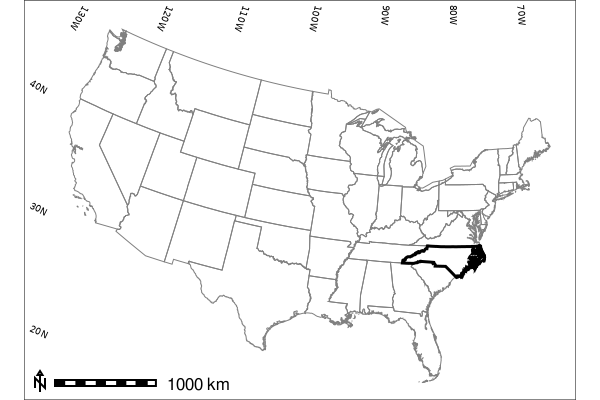

In [4276]:
# priority_queue_clean_med
gs.run_command("g.region",region="CONUS", res=3, flags="pa")
ps_before_3m_cary_map = gj.GrassRenderer(filename="output/us_states.png")
ps_before_3m_cary_map.d_erase()

# ps_before_3m_cary_map.d_rast(map="ps_after_3m_comp")
ps_before_3m_cary_map.d_vect(map="National_Atlas_State_Boundaries_USGS", fill_color="none", color="grey", width="1", flags="s", 
                             where="STATE_FIPS not in ('78','72','15','02')"
                            )
ps_before_3m_cary_map.d_vect(map="National_Atlas_State_Boundaries_USGS", fill_color="none", color="black", width="3", flags="s", 
                             where="STATE_FIPS = '37'"
                            )

ps_before_3m_cary_map.d_grid(size="10:00:00", flags="dw", width=1, color="black",text_color="black")
ps_before_3m_cary_map.d_barscale(at=(5,8), units="meters",font="FreeSans", flags="n")
ps_before_3m_cary_map.show()

## NC View

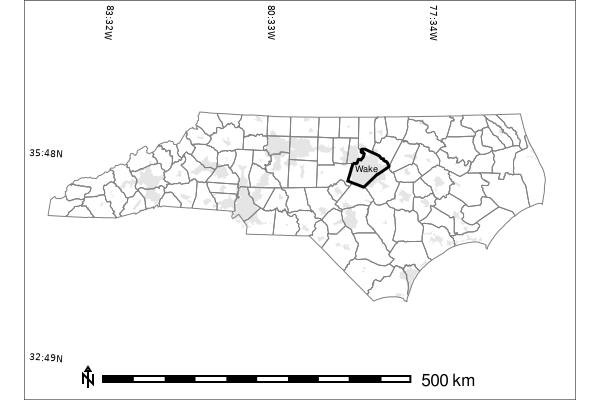

In [4527]:
gs.run_command("g.region",region="nc_state", res=3, flags="pa")

ps_before_3m_cary_map = gj.GrassRenderer(filename="output/nc_counties.png")
ps_before_3m_cary_map.d_erase()
ps_before_3m_cary_map.d_vect(map="NCDOT_Smoothed_Urban_Boundaries_clean", fill_color="229:229:229", color="none", width="3", flags="s", 
                             where="NAME != 'Myrtle Beach--Socastee'"
                            )
ps_before_3m_cary_map.d_vect(map="NC_State_and_County_Boundaries", fill_color="none", color="grey", width="1", flags="s", 
                             #where="STATE_FIPS not in ('78','72','15','02')"
                            )
ps_before_3m_cary_map.d_vect(map="NC_State_and_County_Boundaries", fill_color="none", color="black", width="3", flags="s", 
                             where="FIPS = '183'"
                            )

ps_before_3m_cary_map.d_barscale(at=(13,9), units="meters",font="FreeSans", flags="n")

ps_before_3m_cary_map.d_grid(size="02:59:00", flags="dw", width=1, color="black",text_color="black")

ps_before_3m_cary_map.d_text(at=(60,57),text="Wake", bgcolor="none",font="FreeSans",size=2, color="black")

ps_before_3m_cary_map.show()

## Walnut Creek

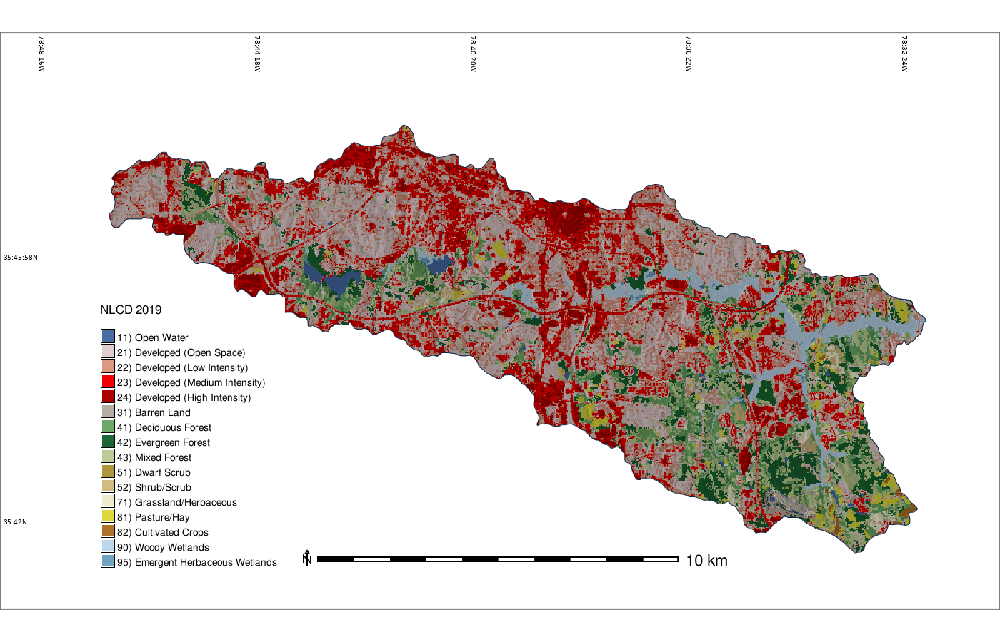

In [4516]:
gs.parse_command("g.region", raster="ned_19sec", res=3, flags="p")
gs.run_command("r.mask",vector="walnut_creek",overwrite=True)

# shadedRelief(elevation="ned_19sec",relief="ned_19sec_relief", output="ned_19sec_shaded_relief")

# gs.run_command("r.shade", shade="ned_19sec_relief", color="nlcd_2019_recl", output="nlcd_2019_recl_shaded_releif", overwrite=True)

gs.run_command("g.region",
               raster="walnut_creek",
               # region="nw_one_third",
               res=3, flags="pa")

view_reg = gs.region("walnut_creek")
view_reg_n = view_reg['n'] + 2500
view_reg_w = view_reg['w'] - 3000
view_reg_e = view_reg['e'] + 2000
view_reg_s = view_reg['s'] - 1500

gs.run_command("g.region",
               raster="walnut_creek",
               n=view_reg_n,
               w=view_reg_w,
               e=view_reg_e,
               s=view_reg_s,
               # region="nw_one_third",
               res=3, flags="pa")

ned_19sec_map = gj.GrassRenderer(height=900, width=1400,filename="output/ned_19sec_shaded_relief.png")
ned_19sec_map.d_erase()

ned_19sec_map.d_rast(map="nlcd_2019_recl_shaded_releif")
ned_19sec_map.d_vect(map="walnut_creek", fill_color="none")
ned_19sec_map.d_legend(raster="nlcd_2019_recl", at=(9,50,10,15),
                    title="NLCD 2019", 
                    title_fontsize=12, 
                    border_color="none",
                    fontsize=10, font="FreeSans",
                    flags="btn")
ned_19sec_map.d_barscale(at=(30,14.5), units="kilometers", flags="n", font="FreeSans",fontsize=16)

ned_19sec_map.d_grid(size="00:03:58", flags="dw", width=1, color="black",text_color="black")

ned_19sec_map.show()

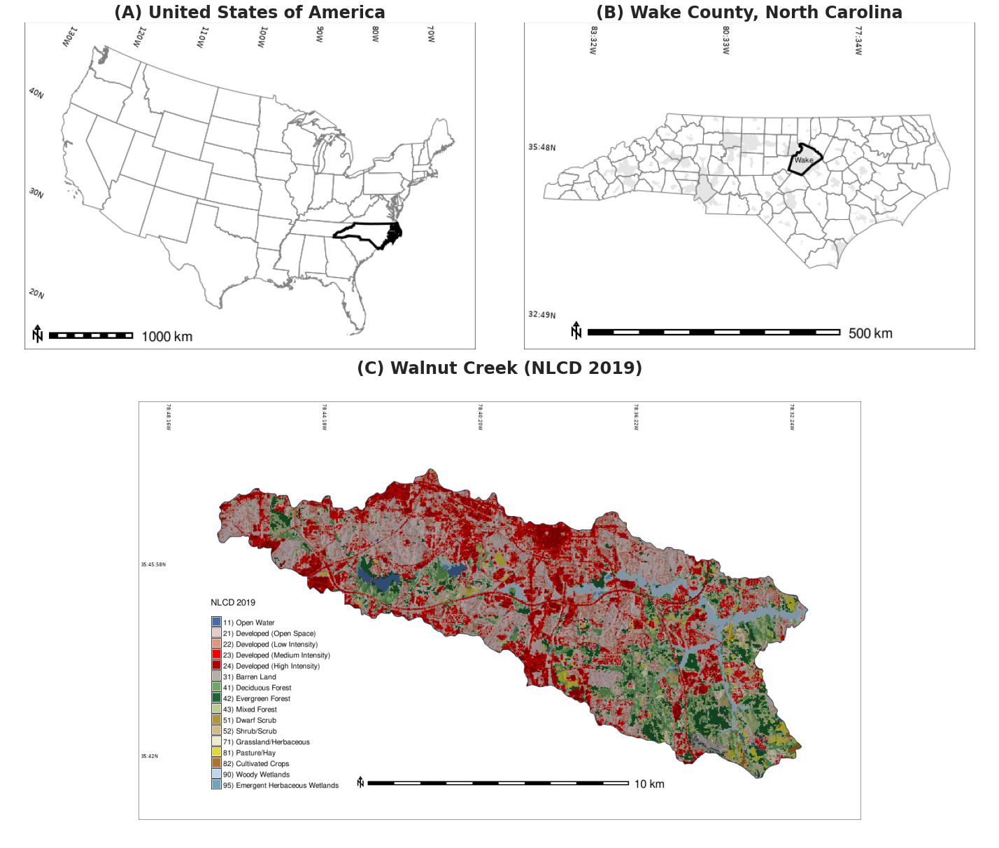

In [4528]:
from PIL import Image

fig = plt.figure(figsize=(20, 18))

# ax = fig.add_subplot(2, 1, 1)
# fig.subplots_adjust(hspace=0, wspace=0.1)

grs = fig.add_gridspec(2, 2)
ax1 = fig.add_subplot(grs[0, 0])
ax1.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.1)

img1 = Image.open("output/us_states.png")
imgplot = plt.imshow(img1)
ax1.set_title('(A) United States of America',{"fontsize":24, "fontweight":"bold"})


ax2 = fig.add_subplot(grs[0, 1])
ax2.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.1)

img1 = Image.open("output/nc_counties.png")
imgplot = plt.imshow(img1)
ax2.set_title('(B) Wake County, North Carolina',{"fontsize":24, "fontweight":"bold"})

# ax2 = fig.add_subplot(grs[0, 2])
# ax2.axis('off')
# fig.subplots_adjust(hspace=0, wspace=0.5)

# img1 = Image.open("output/wake_county.png")
# imgplot = plt.imshow(img1)
# ax2.set_title('(C) Wake County',{"fontsize":24, "fontweight":"bold"})

# spans two rows:
ax3 = fig.add_subplot(grs[1, :])
ax3.axis('off')
fig.subplots_adjust(hspace=0, wspace=0.5)
img2 = Image.open("output/ned_19sec_shaded_relief.png")
imgplot = plt.imshow(img2)
ax3.set_title('(C) Walnut Creek (NLCD 2019)',{"fontsize":24, "fontweight":"bold"})

plt.tight_layout()
plt.savefig("output/study_area.png",bbox_inches='tight', dpi=300)

In [ ]:
# priority_queue_clean_med
gs.run_command("g.region",raster="walnut_creek", res=3, flags="pa")

ps_before_3m_cary_map = gj.GrassRenderer(filename="output/ps_after_3m_priority_queue_map.png")
ps_before_3m_cary_map.d_erase()
ps_before_3m_cary_map.d_rast(map="ps_after_3m_comp")
ps_before_3m_cary_map.d_vect(map="walnut_creek", fill_color="none", color="black", width="1", flags="s")

ps_before_3m_cary_map.d_vect(map="priority_queue_clean_med", fill_color="none", width="2",legend_label="Priority Queue")
ps_before_3m_cary_map.d_legend_vect(at=(60,10,2,6),font="FreeSans", flags="b")

ps_before_3m_cary_map.d_barscale(at=(1,6,2,2), units="meters",font="FreeSans")
ps_before_3m_cary_map.show()